In [1]:
# imports
from keras.applications.inception_v3 import InceptionV3
from keras.models import Model, Input
from keras.layers import Dense, Conv2D, MaxPool2D, Dropout
from keras.layers import Flatten
from keras.applications.vgg16 import decode_predictions
from keras.models import Sequential
from keras.optimizers import Adam, Adamax

import glob
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import tensorflow as tf

In [2]:
seed = 1
np.random.seed(seed)
tf.random.set_seed(seed)

# load data
X = []
Y = []

for filename in glob.glob('/content/drive/MyDrive/images/pretrained/training/anger/*.jpg'):
  im=Image.open(filename).convert('RGB')
  im=im.resize((224,224))
  arr = np.array(im)
  X.append(arr)
  Y.append(1) # anger class

for filename in glob.glob('/content/drive/MyDrive/images/pretrained/training/disgust/*.jpg'):
  im=Image.open(filename).convert('RGB')
  im=im.resize((224,224))
  arr = np.array(im)
  X.append(arr)
  Y.append(2) # disgust class

for filename in glob.glob('/content/drive/MyDrive/images/pretrained/training/fear/*.jpg'):
  im=Image.open(filename).convert('RGB')
  im=im.resize((224,224))
  arr = np.array(im)
  X.append(arr)
  Y.append(3) # fear class

for filename in glob.glob('/content/drive/MyDrive/images/pretrained/training/happy/*.jpg'):
  im=Image.open(filename).convert('RGB')
  im=im.resize((224,224))
  arr = np.array(im)
  X.append(arr)
  Y.append(4) # happy class

for filename in glob.glob('/content/drive/MyDrive/images/pretrained/training/neutral/*.jpg'):
  im=Image.open(filename).convert('RGB')
  im=im.resize((224,224))
  arr = np.array(im)
  X.append(arr)
  Y.append(5) # neutral class

for filename in glob.glob('/content/drive/MyDrive/images/pretrained/training/sad/*.jpg'):
  im=Image.open(filename).convert('RGB')
  im=im.resize((224,224))
  arr = np.array(im)
  X.append(arr)
  Y.append(6) # sad class

for filename in glob.glob('/content/drive/MyDrive/images/pretrained/training/surprised/*.jpg'):
  im=Image.open(filename).convert('RGB')
  im=im.resize((224,224))
  arr = np.array(im)
  X.append(arr)
  Y.append(7) # surprised class

# convert to np array
X = np.array(X)

# reshape 
X = X.reshape(X.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
X = X /255

# encode outputs
Y = np.array(Y)

# randomize the data set - numpy arrays
randomize = np.arange(len(X))
np.random.shuffle(randomize)
X = X[randomize]
Y = Y[randomize]

Y = tf.keras.utils.to_categorical(Y)
num_classes = Y.shape[1]

In [3]:
inception = InceptionV3(include_top=False, weights='imagenet', input_shape=(224,224,3))
output = inception.layers[-1].output
output = tf.keras.layers.Flatten()(output)
inception = Model(inception.input, outputs=output)
for layer in inception.layers:
    layer.trainable = False
inception.summary()

87916544/87910968 [==============================] - 1s 0us/step
Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 111, 111, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 111, 111, 32) 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 111, 111, 32) 0           batch_normalization[0][0]        
_____________________________

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
model (Functional)           (None, 51200)             21802784  
_________________________________________________________________
dense_3 (Dense)              (None, 512)               26214912  
_________________________________________________________________
dropout_2 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_4 (Dense)              (None, 512)               262656    
_________________________________________________________________
dropout_3 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_5 (Dense)              (None, 8)                 4104      
Total params: 48,284,456
Trainable params: 26,481,672
Non-trainable params: 21,802,784
_________________________________

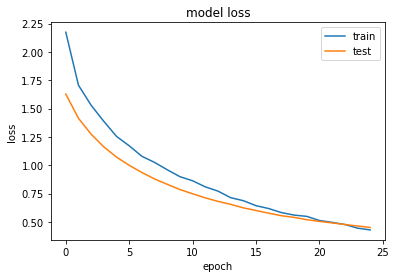

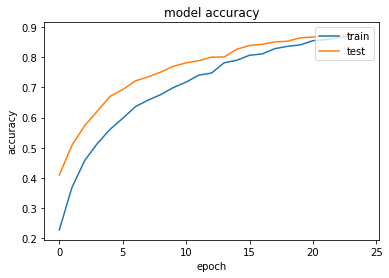

In [5]:
# creation of the model, using the resnet architecture and adding my own classes after the flattening layer
model = Sequential()
model.add(inception)
model.add(Dense(512, activation='relu', input_dim= (224, 224, 3)))
model.add(Dropout(0.3))
model.add(Dense(512, activation='relu'))
model.add(Dropout(0.3))
model.add(Dense(num_classes, activation='softmax'))

# summary of the model
model.summary()

# specifying a learning rate to optimizer adam
opt = tf.keras.optimizers.Adam(lr=0.000001)
# compiling the model
model.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['acc'])

# Fit the model
history = model.fit(X, Y, validation_split=0.40, epochs=25, batch_size=32, verbose=1)

# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper right')
plt.show()

# summarize history for accuracy
plt.plot(history.history['acc'])
plt.plot(history.history['val_acc'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper right')
plt.show()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
model (Functional)           (None, 51200)             21802784  
_________________________________________________________________
dense_6 (Dense)              (None, 512)               26214912  
_________________________________________________________________
dropout_4 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_7 (Dense)              (None, 512)               262656    
_________________________________________________________________
dropout_5 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_8 (Dense)              (None, 8)                 4104      
Total params: 48,284,456
Trainable params: 26,481,672
Non-trainable params: 21,802,784
_________________________________

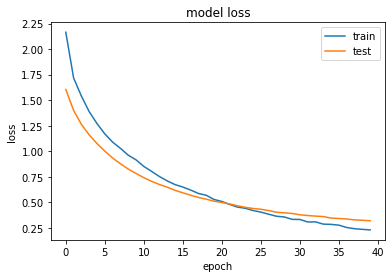

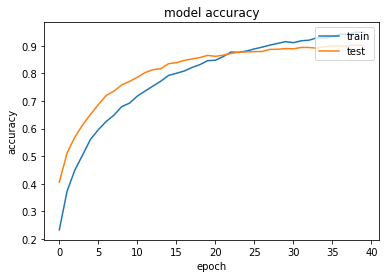

In [6]:
# creation of the model, using the resnet architecture and adding my own classes after the flattening layer
model2 = Sequential()
model2.add(inception)
model2.add(Dense(512, activation='relu', input_dim= (224, 224, 3)))
model2.add(Dropout(0.3))
model2.add(Dense(512, activation='relu'))
model2.add(Dropout(0.3))
model2.add(Dense(num_classes, activation='softmax'))

# summary of the model
model2.summary()

# specifying a learning rate to optimizer adam
opt = tf.keras.optimizers.Adam(lr=0.000001)
# compiling the model
model2.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['acc'])

# Fit the model
history = model2.fit(X, Y, validation_split=0.40, epochs=40, batch_size=32, verbose=1)

# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper right')
plt.show()

# summarize history for accuracy
plt.plot(history.history['acc'])
plt.plot(history.history['val_acc'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper right')
plt.show()

**Predictions**

**Angry**

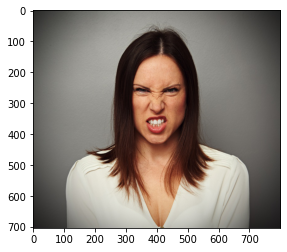

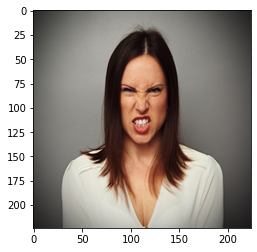

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


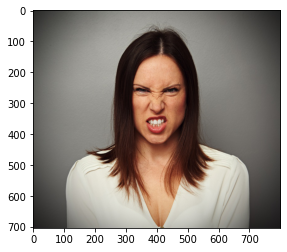

You are surprised


In [9]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Angry/Angry1.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

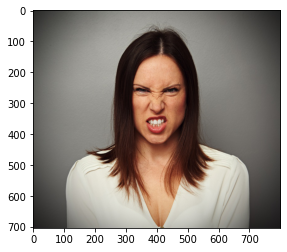

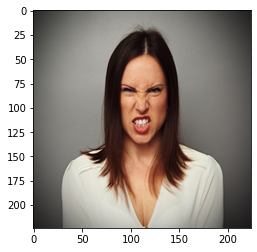

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


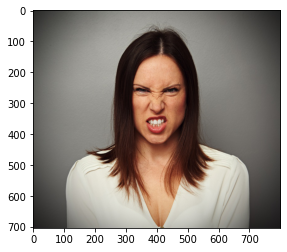

You are surprised


In [10]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Angry/Angry2.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

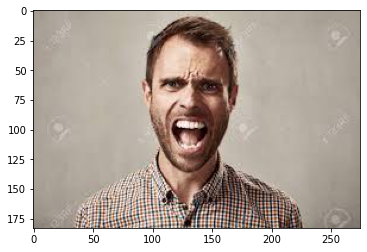

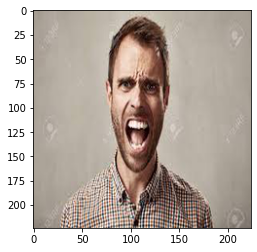

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


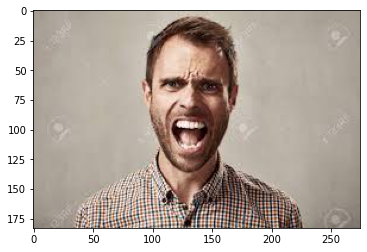

you are happy


In [11]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Angry/Angry3.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

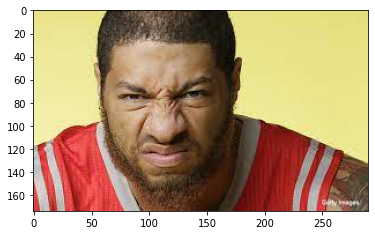

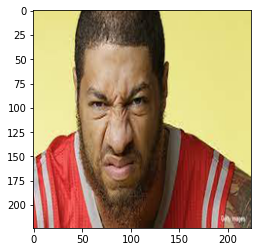

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


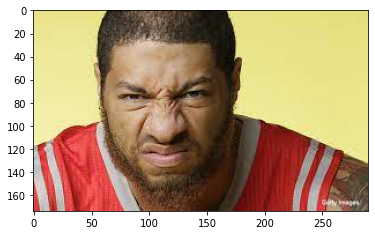

You are angry


In [12]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Angry/Angry4.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

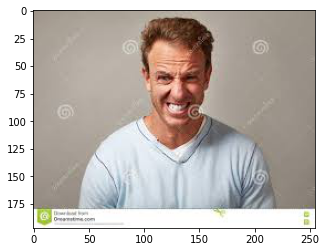

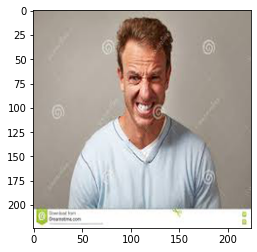

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


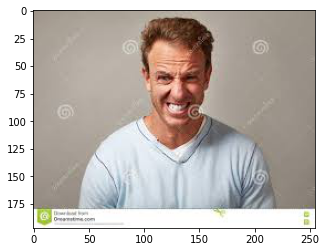

you are happy


In [13]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Angry/Angry5.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

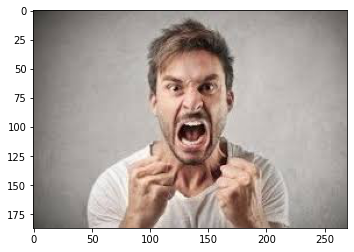

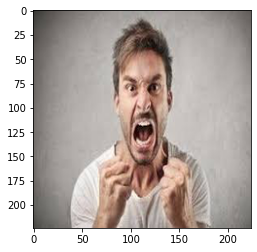

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


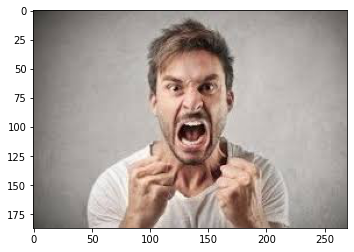

you are happy


In [14]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Angry/Angry6.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

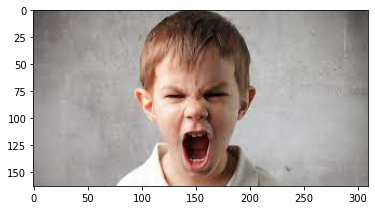

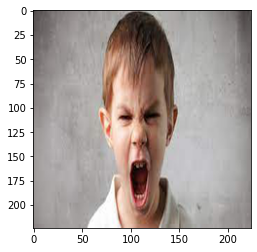

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


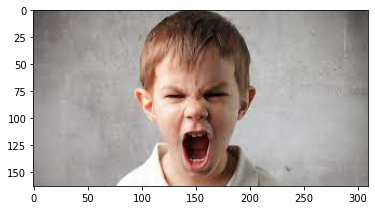

You are surprised


In [15]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Angry/Angry7.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

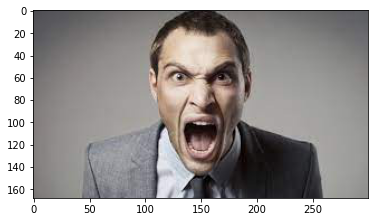

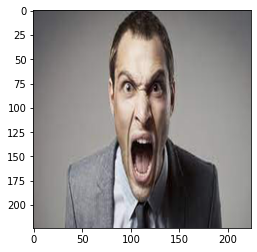

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


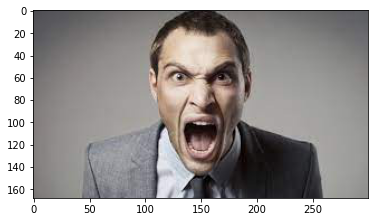

You are sad


In [16]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Angry/Angry8.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

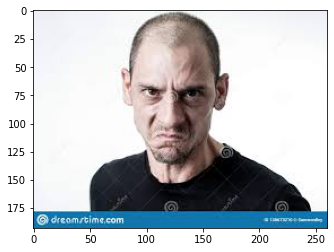

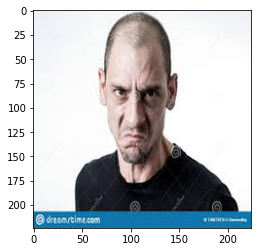

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


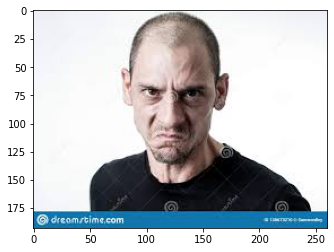

you are fear


In [17]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Angry/Angry9.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

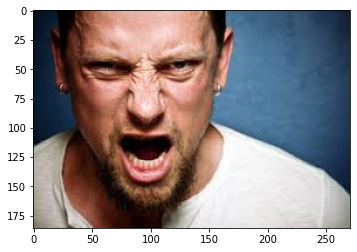

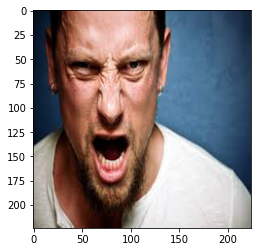

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


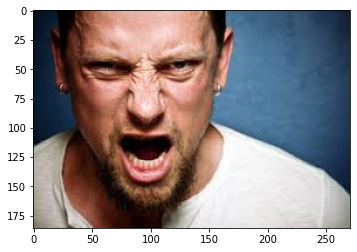

you are fear


In [18]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Angry/Angry10.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

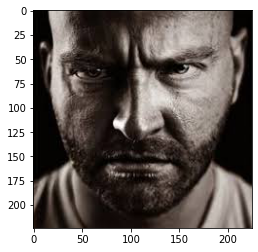

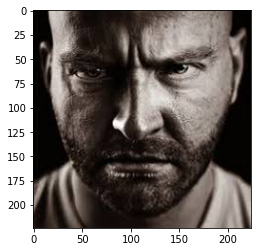

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


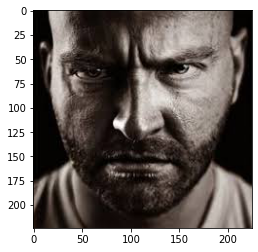

You are surprised


In [19]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Angry/Angry11.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

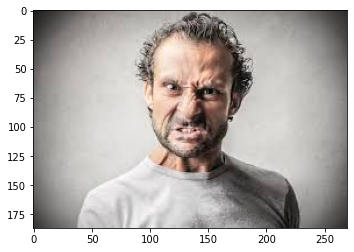

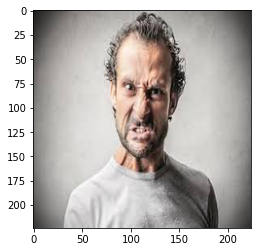

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


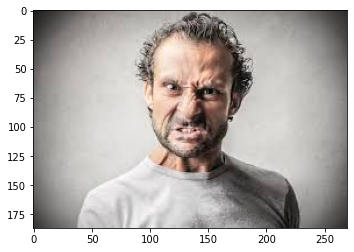

you are fear


In [20]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Angry/Angry12.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

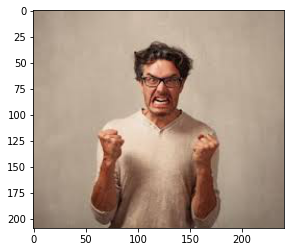

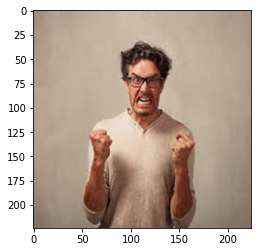

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


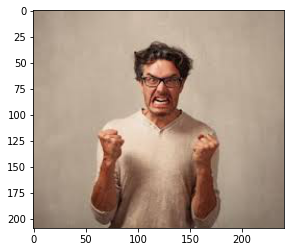

you are fear


In [21]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Angry/Angry13.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

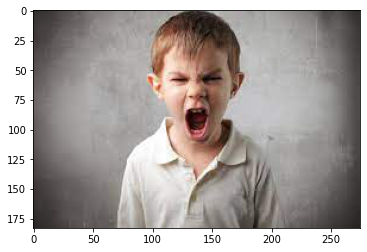

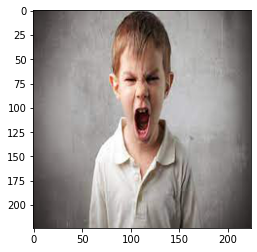

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


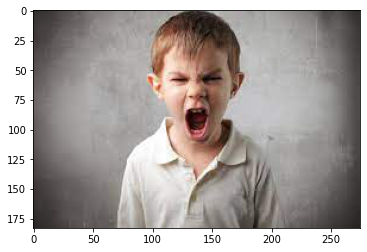

You are sad


In [22]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Angry/Angry14.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

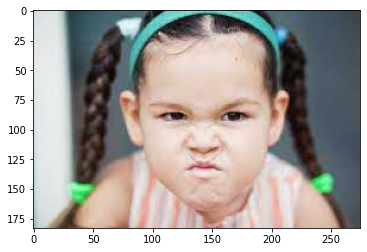

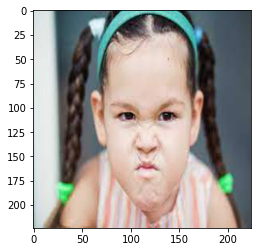

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


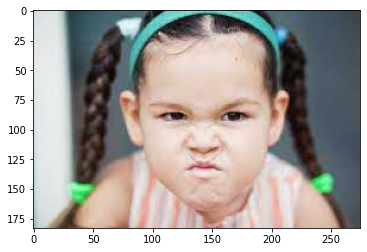

you are happy


In [23]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Angry/Angry15.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

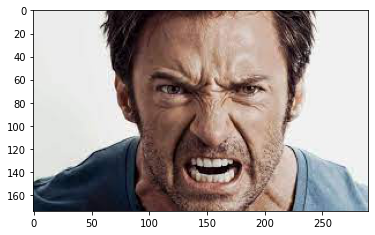

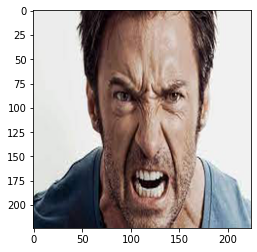

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


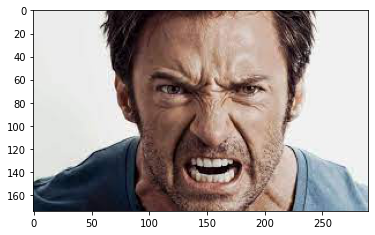

You are sad


In [24]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Angry/Angry16.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

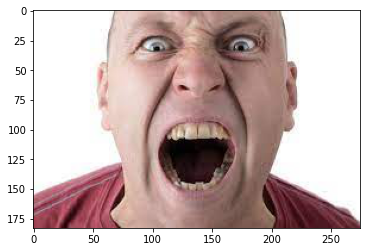

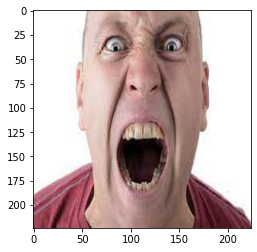

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


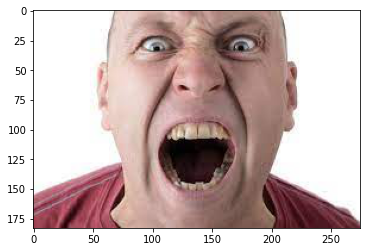

You are surprised


In [25]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Angry/Angry17.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

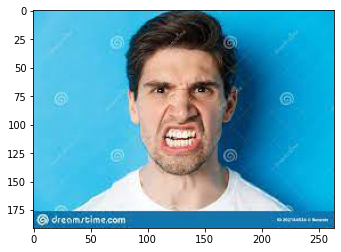

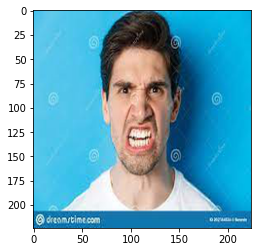

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


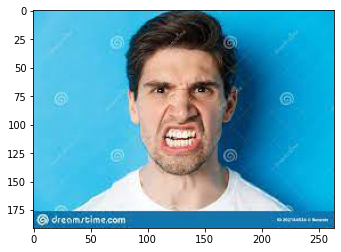

You are surprised


In [26]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Angry/Angry18.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

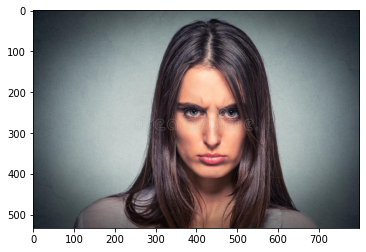

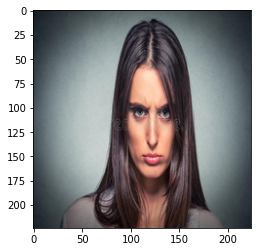

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


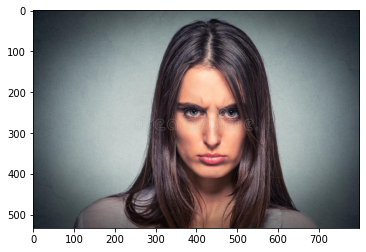

You are surprised


In [27]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Angry/Angry19.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

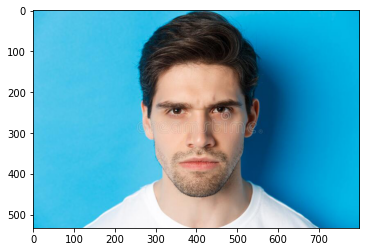

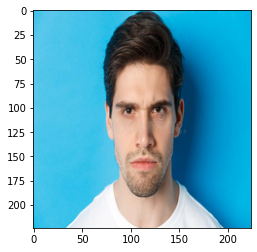

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


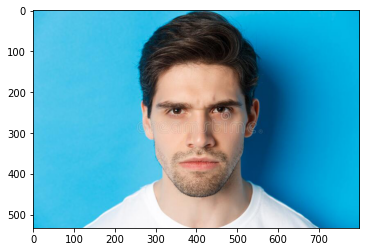

You are surprised


In [28]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Angry/Angry20.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

**Disgust**

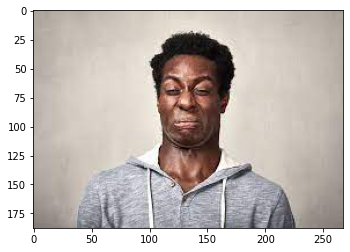

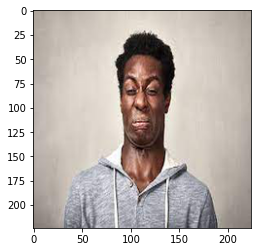

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


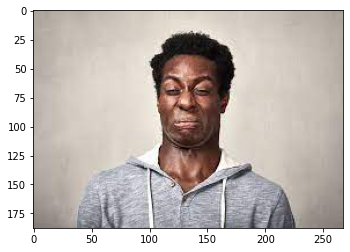

You are sad


In [29]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Disgust/Disgust1.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

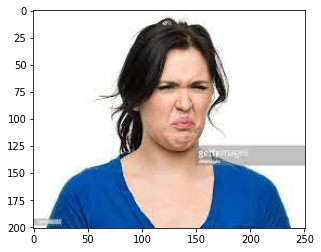

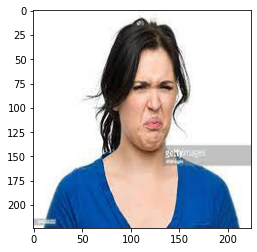

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


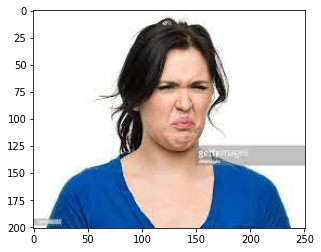

you are happy


In [30]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Disgust/Disgust2.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

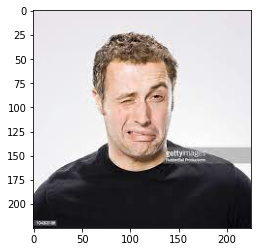

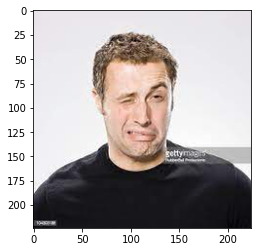

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


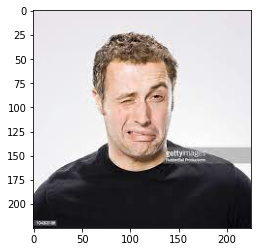

you are fear


In [31]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Disgust/Disgust3.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

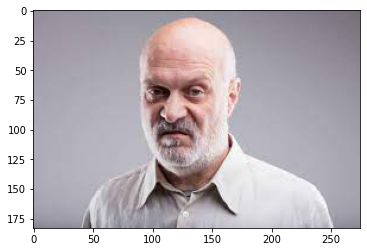

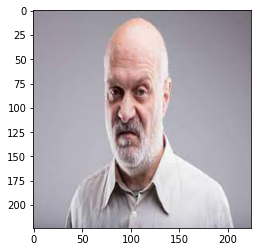

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


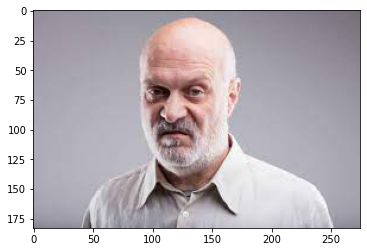

you are fear


In [32]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Disgust/Disgust4.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

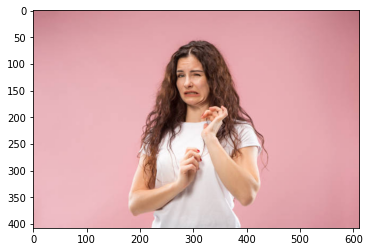

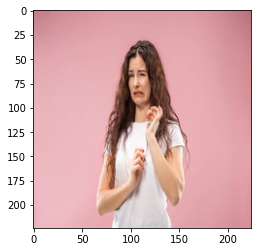

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


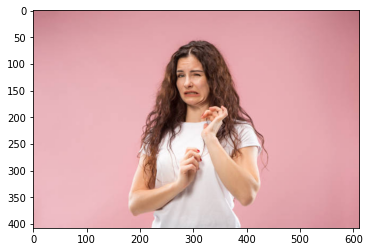

you are happy


In [33]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Disgust/Disgust5.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

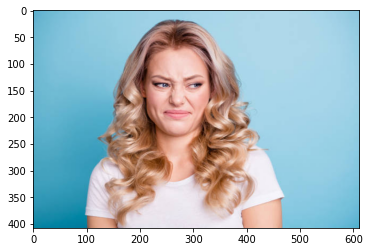

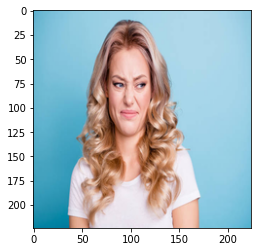

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


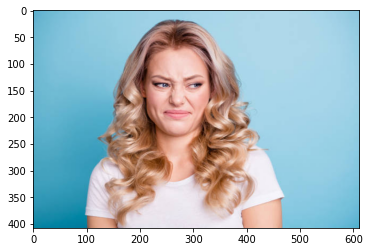

you are happy


In [34]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Disgust/Disgust6.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

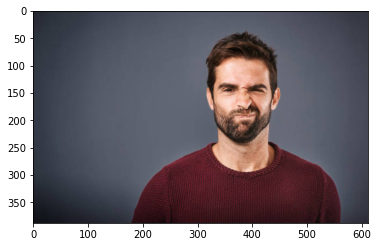

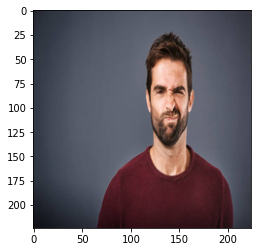

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


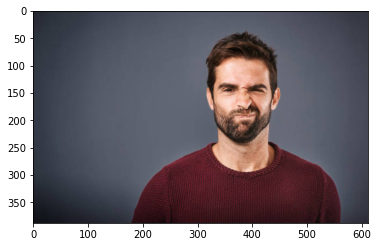

you are fear


In [35]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Disgust/Disgust7.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

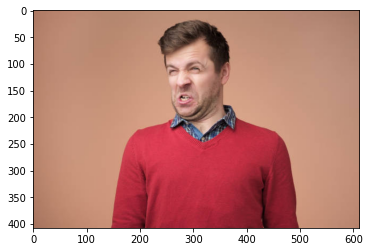

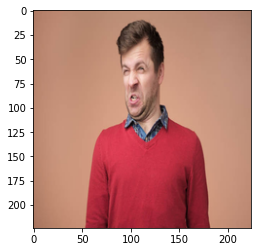

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


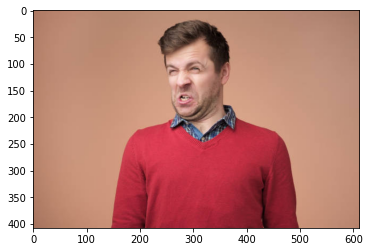

You are surprised


In [36]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Disgust/Disgust8.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

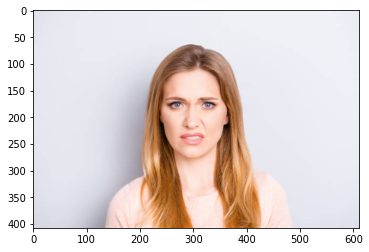

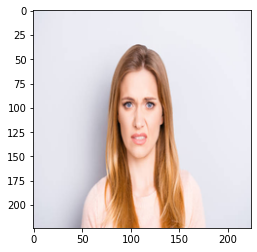

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


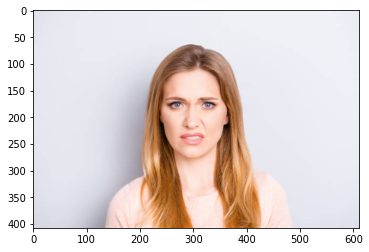

You are surprised


In [37]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Disgust/Disgust9.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

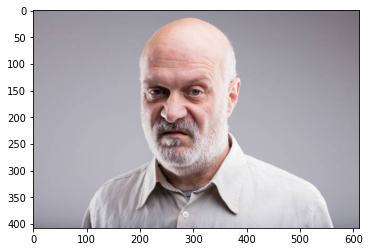

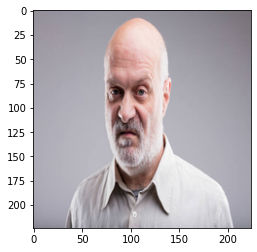

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


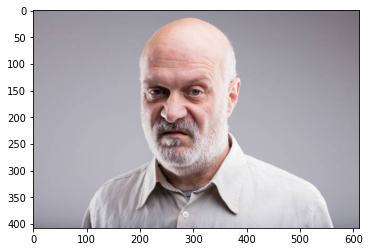

You are sad


In [38]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Disgust/Disgust10.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

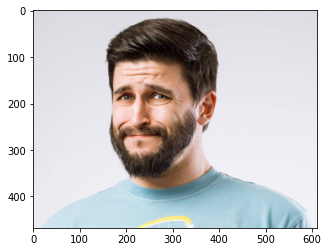

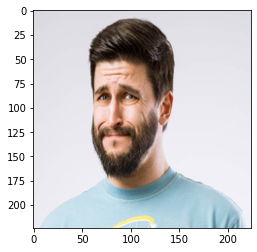

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


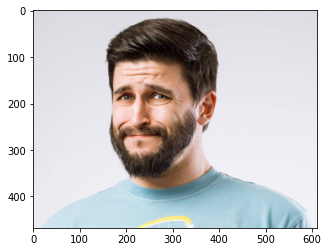

You are surprised


In [39]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Disgust/Disgust11.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

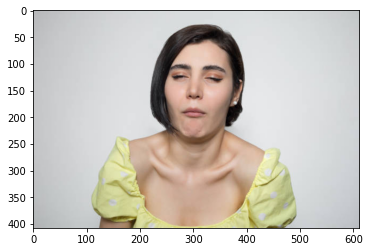

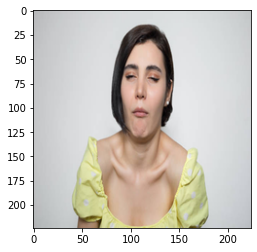

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


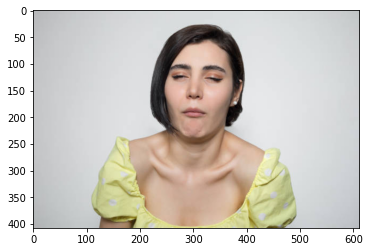

You are surprised


In [40]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Disgust/Disgust12.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

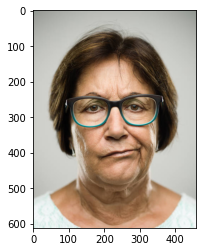

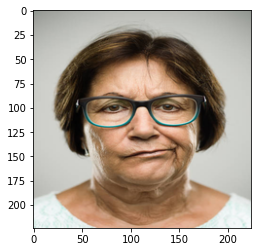

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


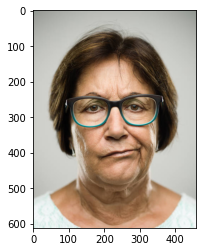

You are surprised


In [41]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Disgust/Disgust13.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

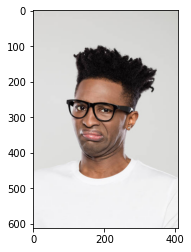

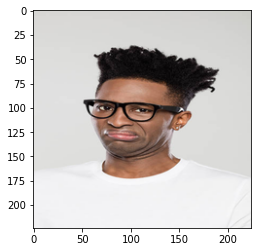

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


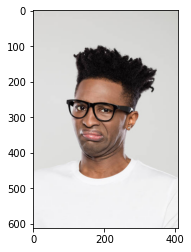

You are surprised


In [42]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Disgust/Disgust14.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

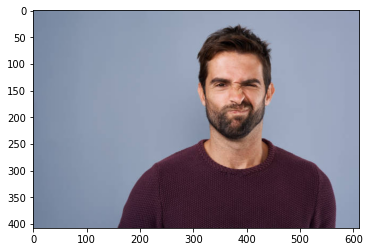

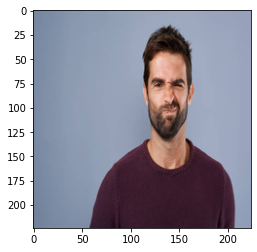

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


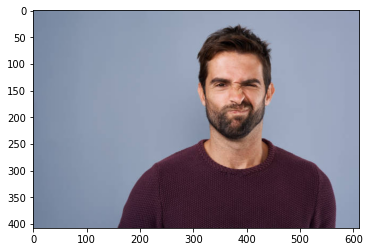

you are fear


In [43]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Disgust/Disgust15.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

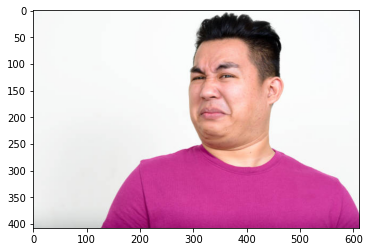

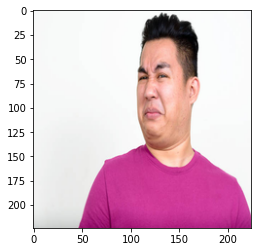

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


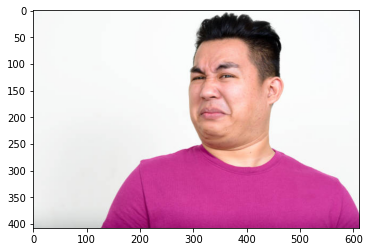

You are surprised


In [44]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Disgust/Disgust16.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

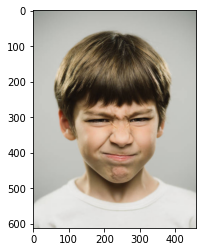

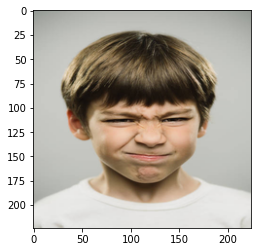

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


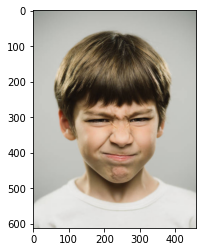

you are happy


In [45]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Disgust/Disgust17.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

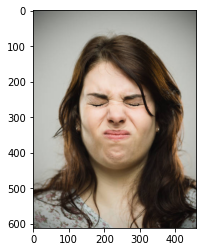

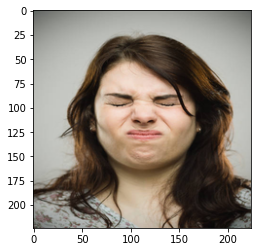

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


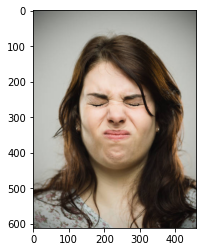

you are happy


In [46]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Disgust/Disgust18.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

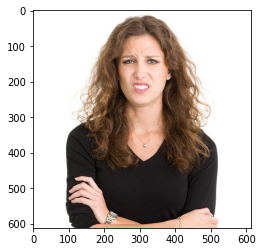

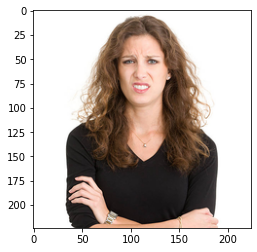

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


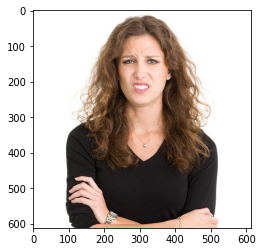

You are sad


In [47]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Disgust/Disgust19.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

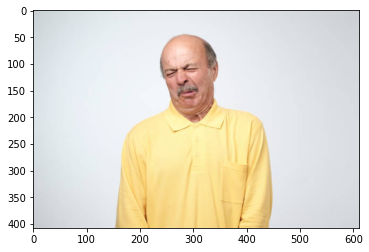

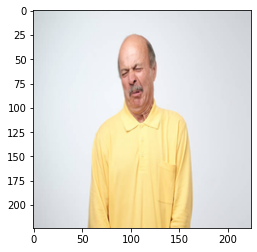

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


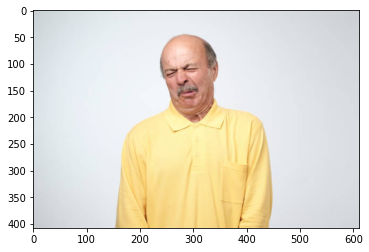

You are sad


In [48]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Disgust/Disgust20.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

**Fear**

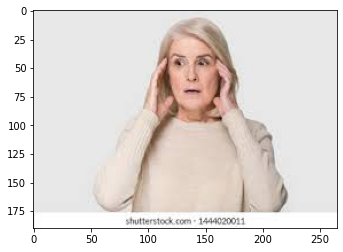

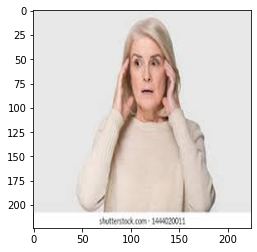

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


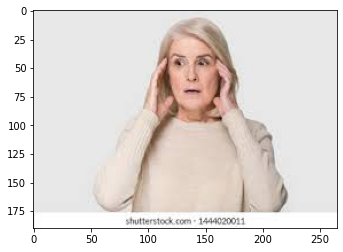

You are disgusted


In [49]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Fear/Fear1.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

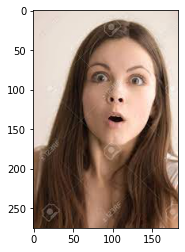

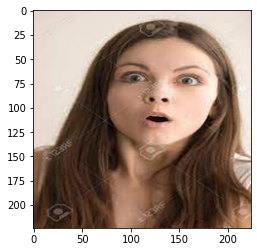

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


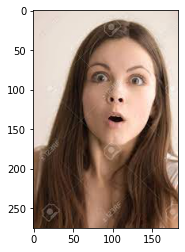

You are surprised


In [50]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Fear/Fear2.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

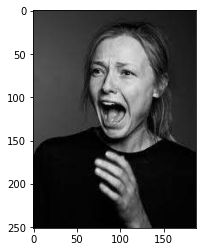

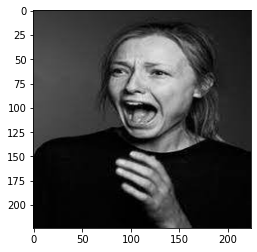

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


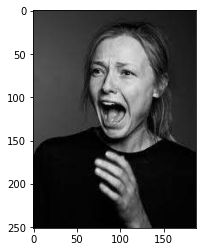

you are happy


In [51]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Fear/Fear3.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

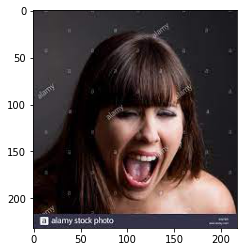

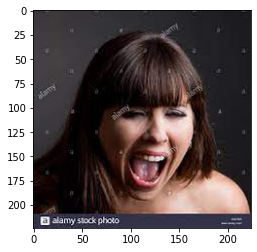

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


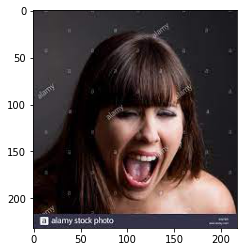

You are surprised


In [52]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Fear/Fear4.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

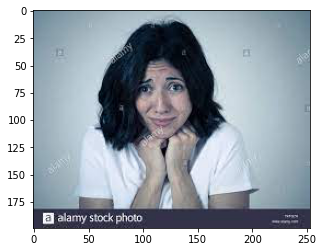

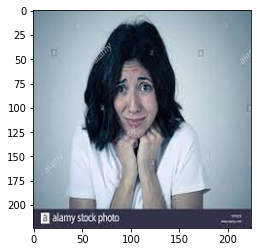

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


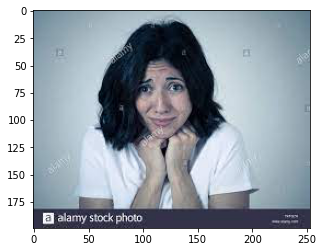

you are happy


In [53]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Fear/Fear5.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

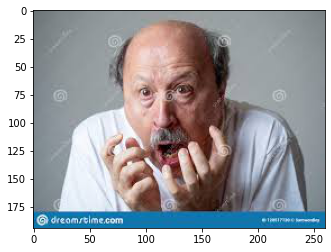

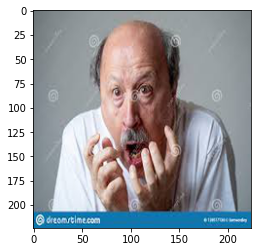

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


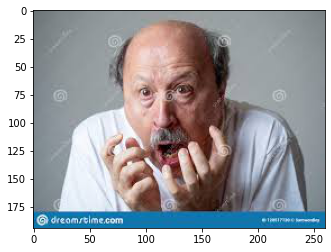

You are surprised


In [54]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Fear/Fear6.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

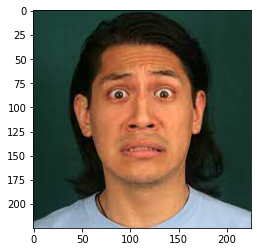

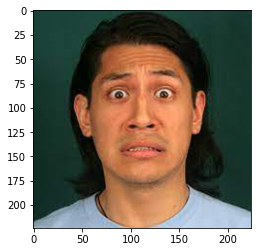

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


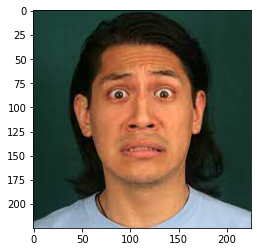

You are surprised


In [55]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Fear/Fear7.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

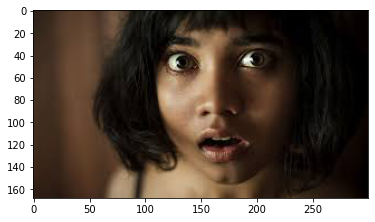

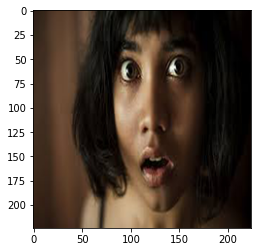

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


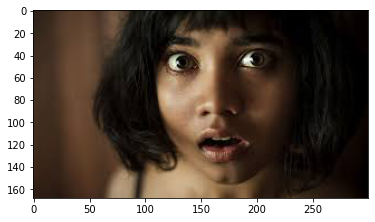

You are surprised


In [56]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Fear/Fear8.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

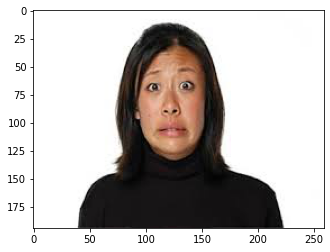

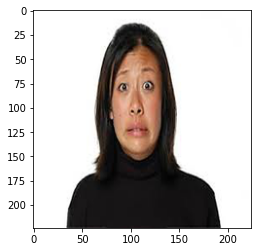

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


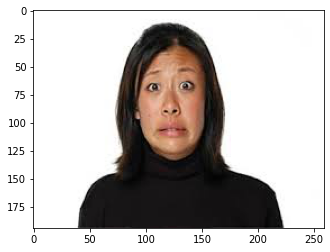

You are surprised


In [57]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Fear/Fear9.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

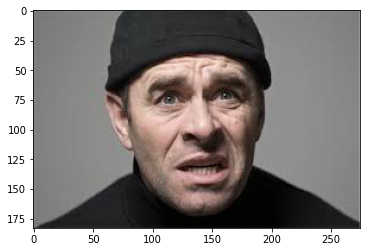

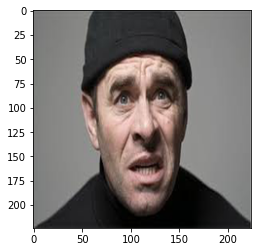

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


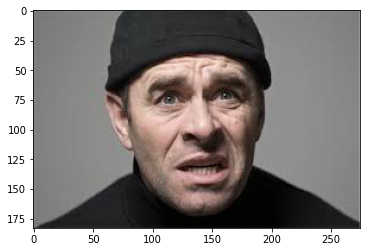

You are sad


In [58]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Fear/Fear10.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

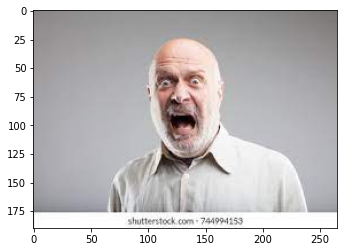

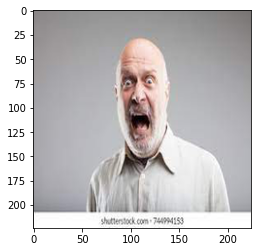

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


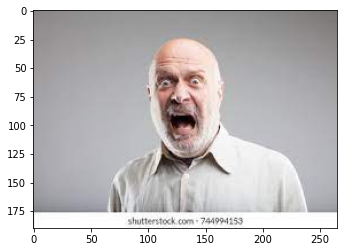

you are fear


In [59]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Fear/Fear11.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

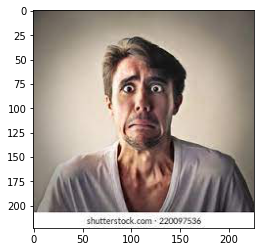

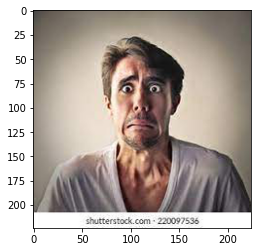

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


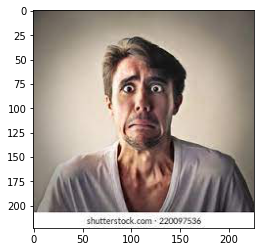

You are surprised


In [60]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Fear/Fear12.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

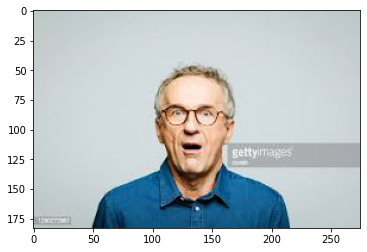

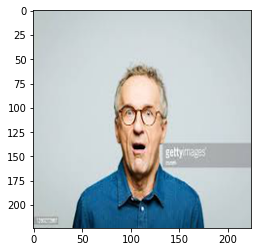

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


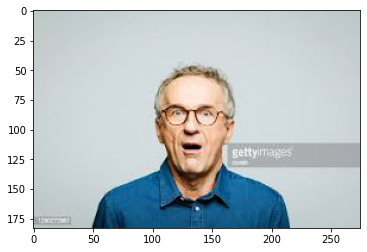

you are happy


In [61]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Fear/Fear13.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

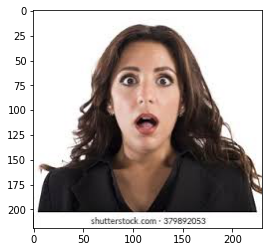

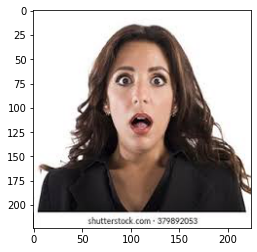

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


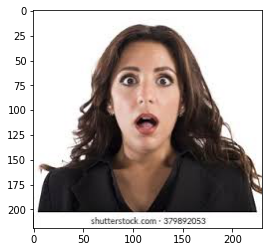

you are happy


In [62]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Fear/Fear14.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

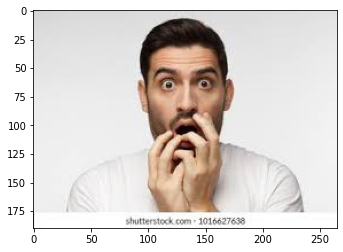

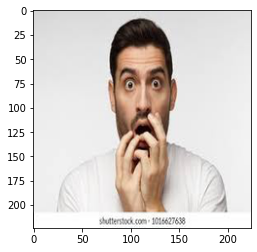

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


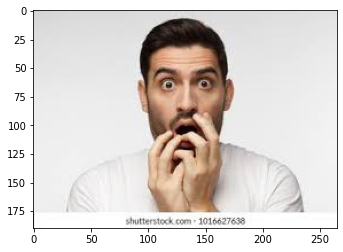

You are surprised


In [63]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Fear/Fear15.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

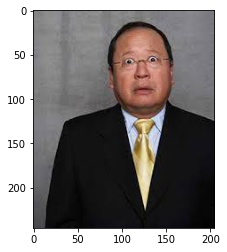

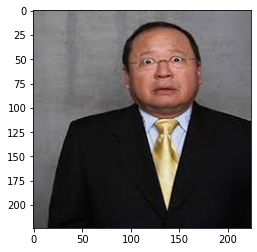

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


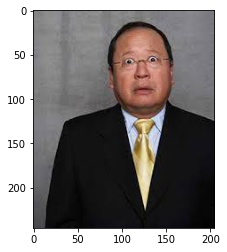

you are fear


In [64]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Fear/Fear16.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

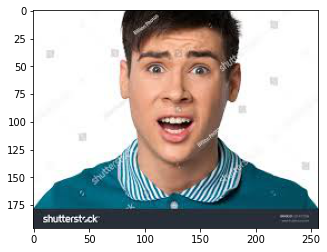

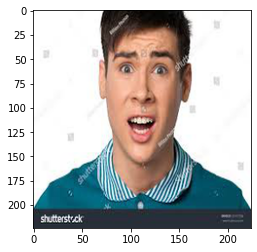

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


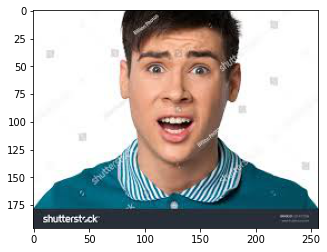

You are surprised


In [65]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Fear/Fear17.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

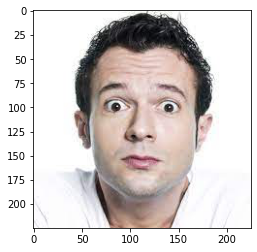

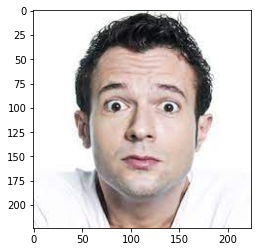

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


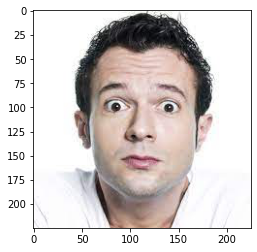

You are surprised


In [66]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Fear/Fear18.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

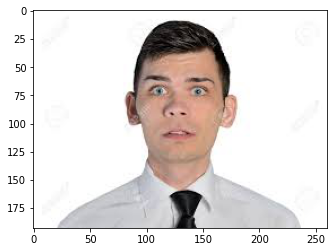

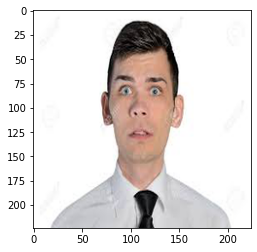

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


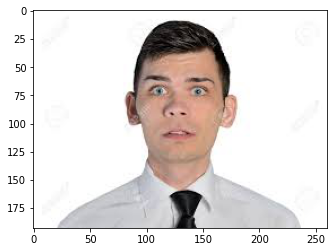

You are surprised


In [67]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Fear/Fear19.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

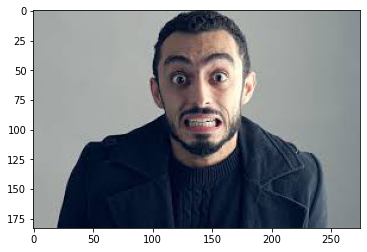

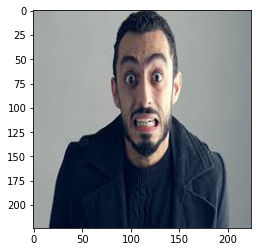

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


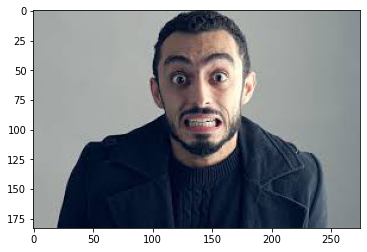

You are sad


In [68]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Fear/Fear20.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

**Happy**

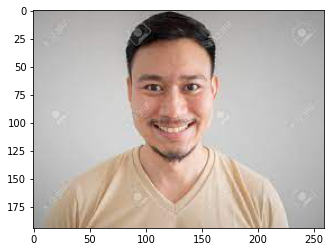

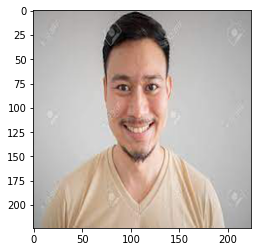

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


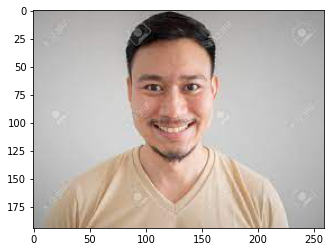

You are surprised


In [69]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Happy/Happy1.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

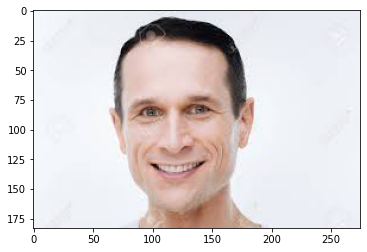

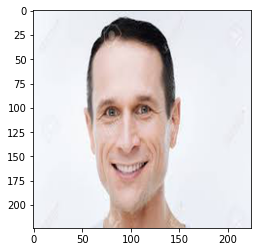

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


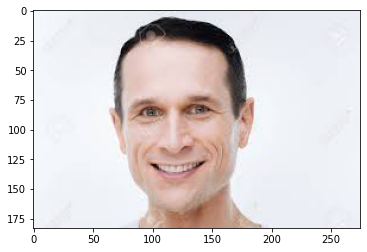

you are happy


In [70]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Happy/Happy2.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

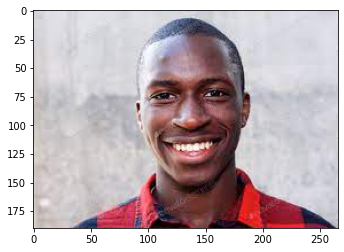

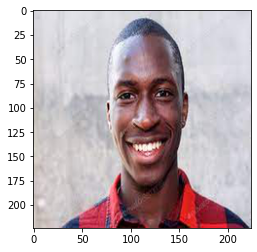

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


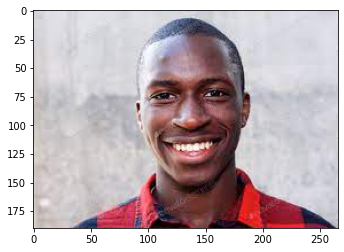

you are happy


In [71]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Happy/Happy3.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

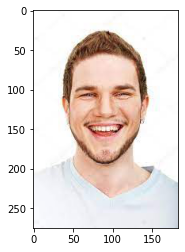

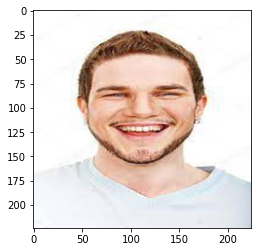

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


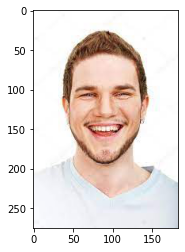

you are happy


In [72]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Happy/Happy4.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

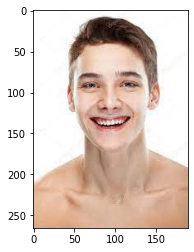

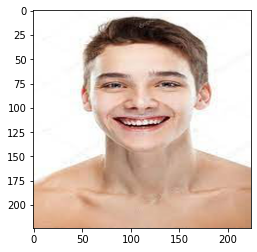

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


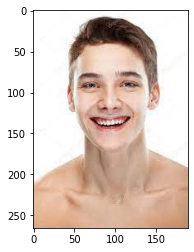

you are happy


In [73]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Happy/Happy5.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

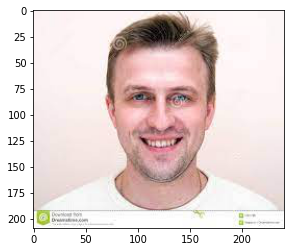

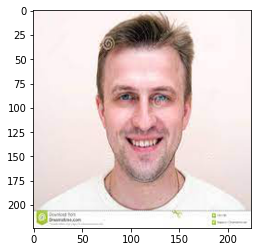

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


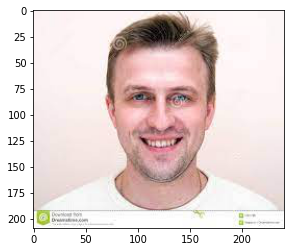

you are happy


In [74]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Happy/Happy6.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

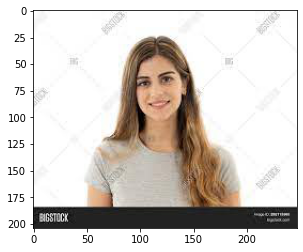

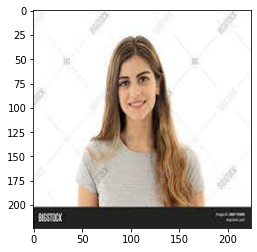

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


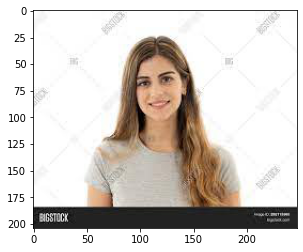

You are surprised


In [75]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Happy/Happy7.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

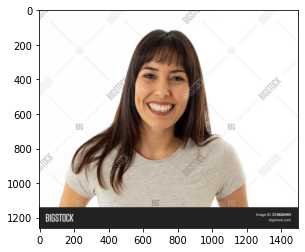

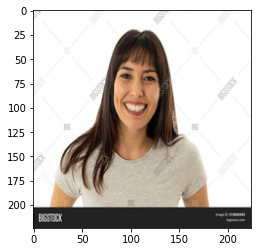

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


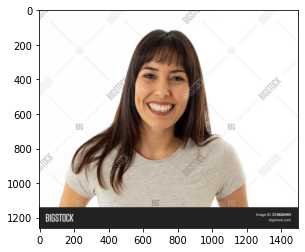

You are surprised


In [76]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Happy/Happy8.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

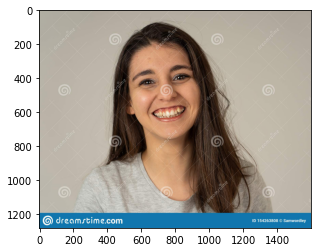

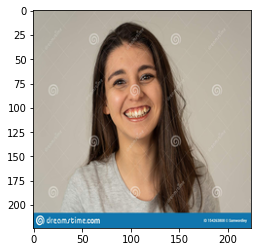

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


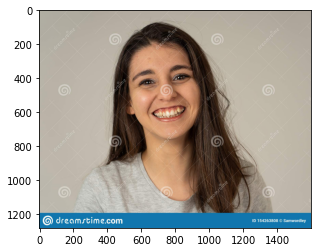

You are surprised


In [77]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Happy/Happy9.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

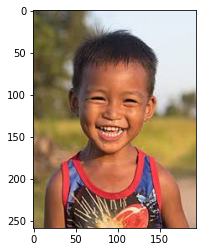

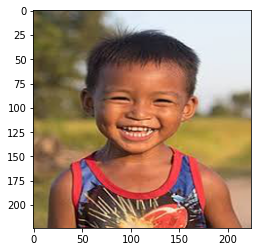

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


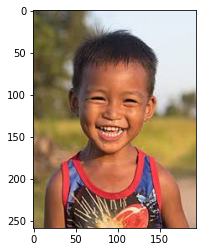

you are fear


In [78]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Happy/Happy10.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

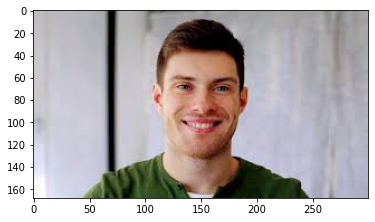

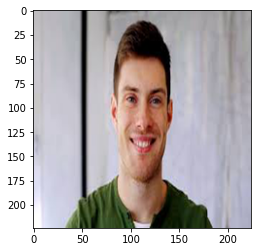

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


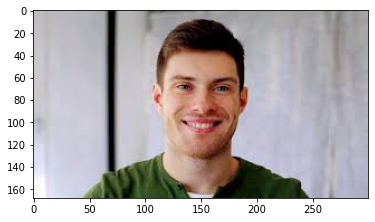

you are happy


In [79]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Happy/Happy11.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

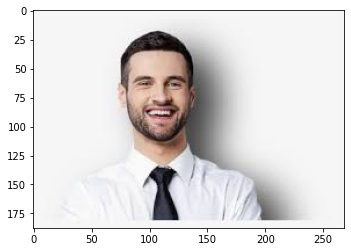

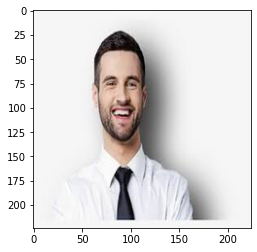

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


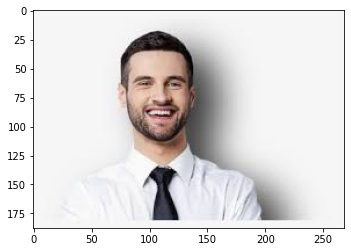

you are happy


In [80]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Happy/Happy12.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

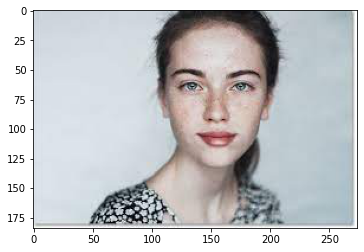

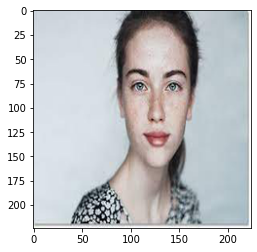

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


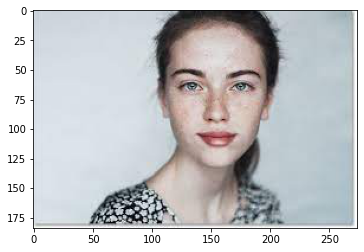

You are surprised


In [81]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Happy/Happy13.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

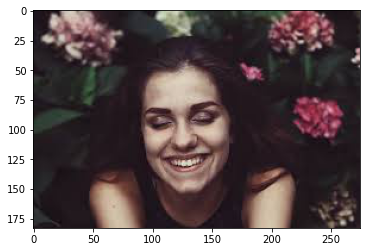

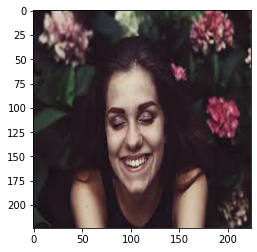

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


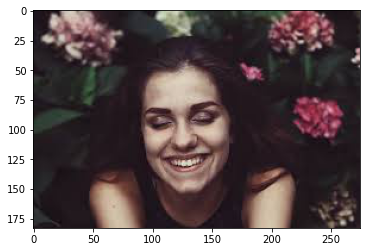

you are happy


In [82]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Happy/Happy14.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

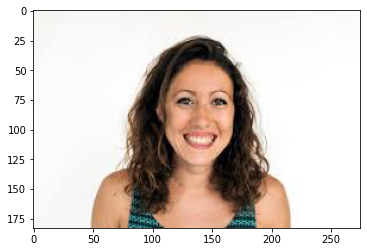

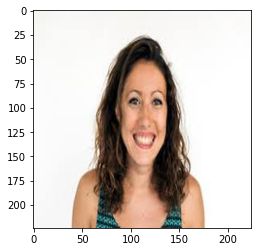

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


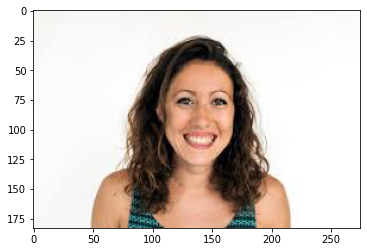

You are surprised


In [83]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Happy/Happy15.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

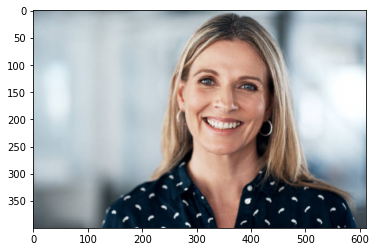

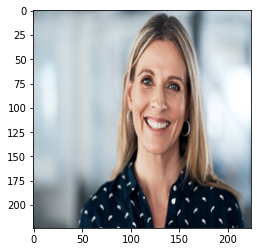

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


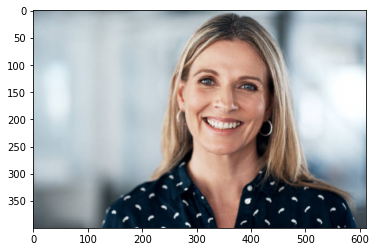

you are happy


In [84]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Happy/Happy16.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

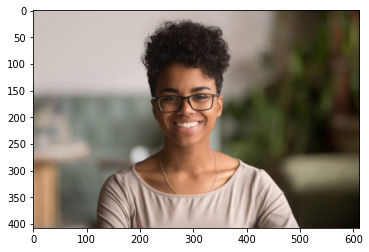

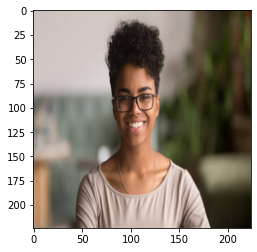

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


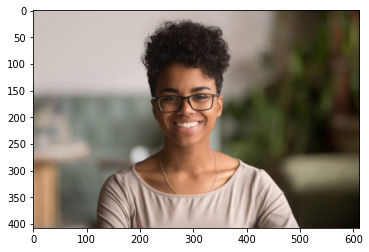

You are surprised


In [85]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Happy/Happy17.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

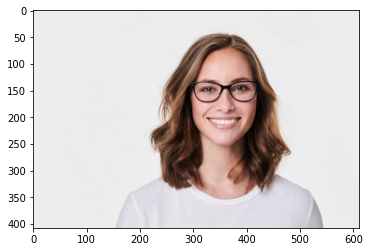

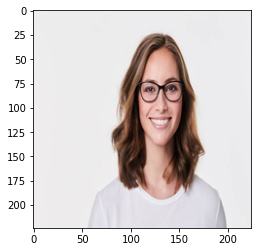

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


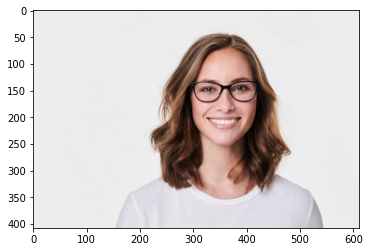

You are surprised


In [86]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Happy/Happy18.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

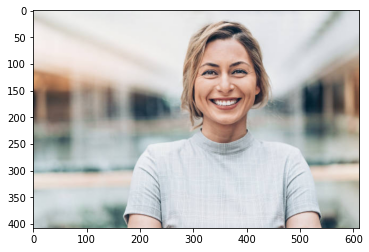

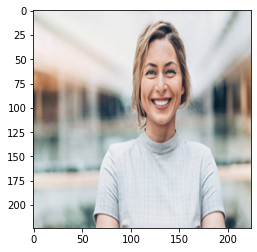

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


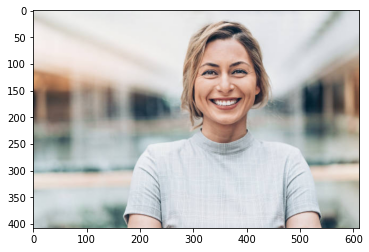

You are surprised


In [87]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Happy/Happy19.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

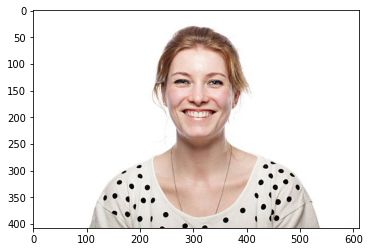

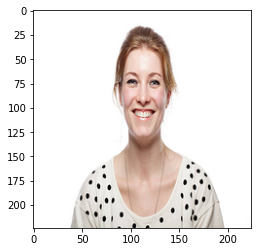

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


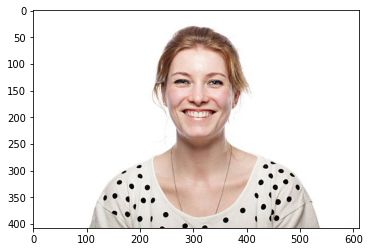

You are surprised


In [88]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Happy/Happy20.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

**Neutral**

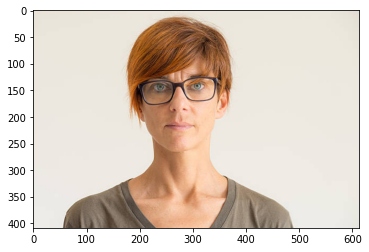

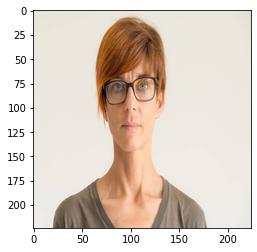

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


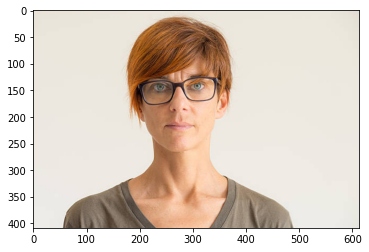

you are happy


In [89]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Neutral/Neutral1.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

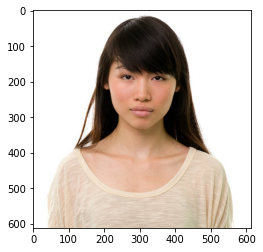

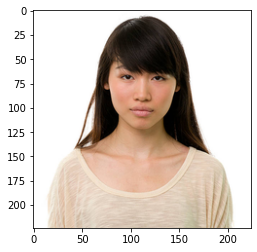

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


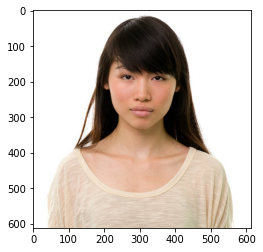

You are surprised


In [90]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Neutral/Neutral2.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

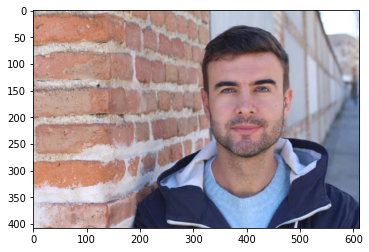

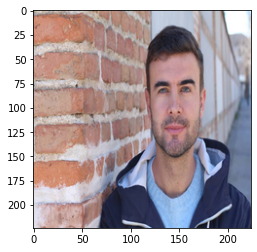

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


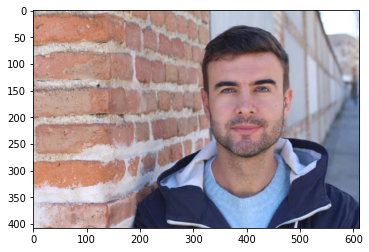

You are surprised


In [91]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Neutral/Neutral3.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

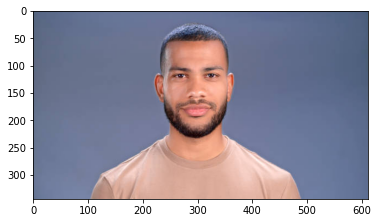

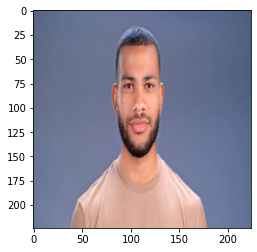

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


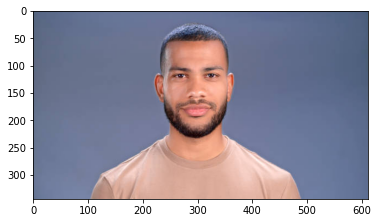

You are surprised


In [92]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Neutral/Neutral4.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

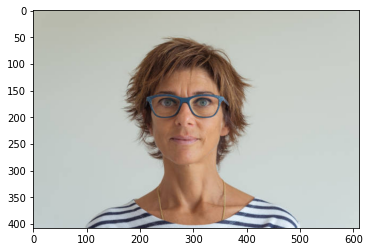

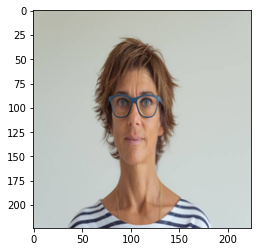

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


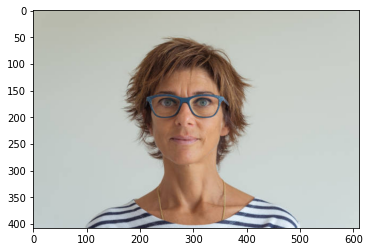

You are surprised


In [93]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Neutral/Neutral5.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

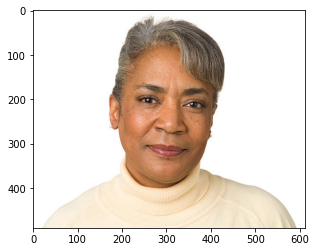

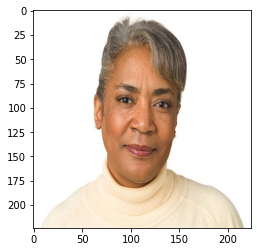

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


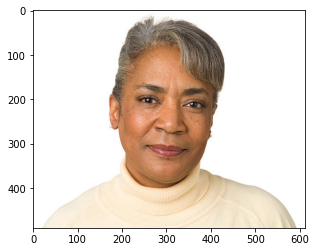

You are surprised


In [94]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Neutral/Neutral6.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

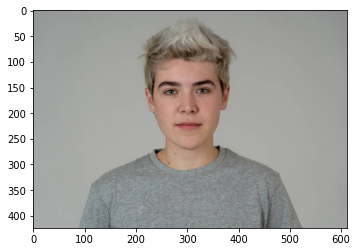

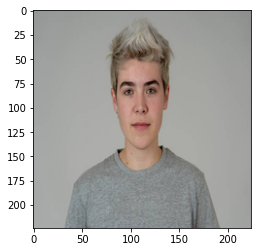

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


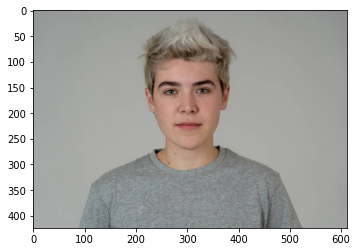

you are fear


In [95]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Neutral/Neutral7.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

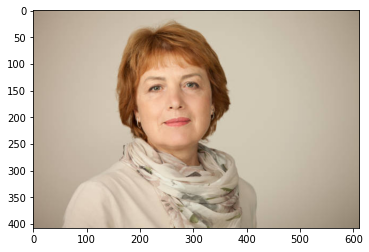

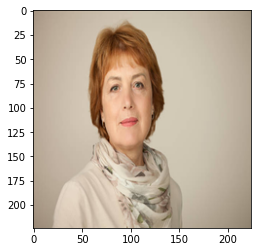

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


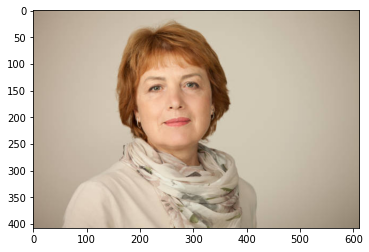

You are surprised


In [97]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Neutral/Neutral8.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

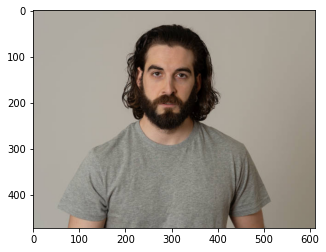

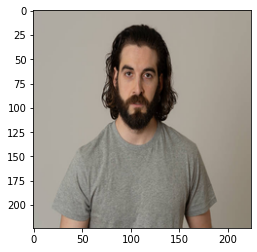

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


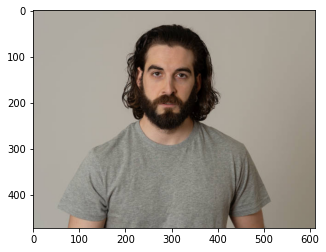

You are disgusted


In [98]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Neutral/Neutral9.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

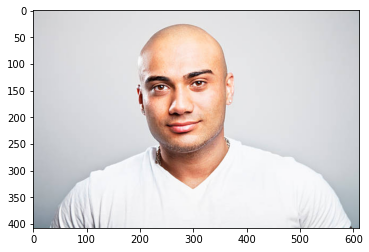

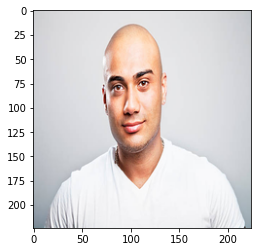

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


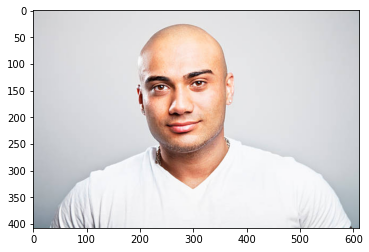

You are surprised


In [99]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Neutral/Neutral10.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

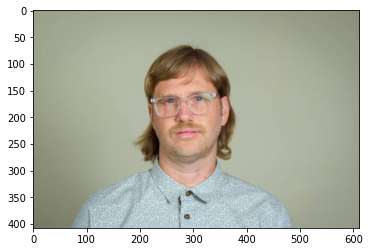

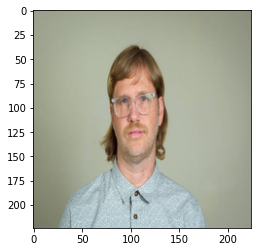

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


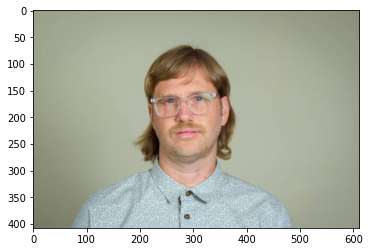

you are happy


In [100]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Neutral/Neutral11.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

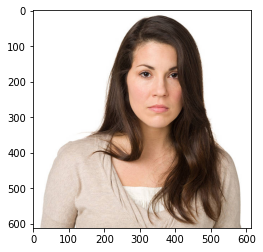

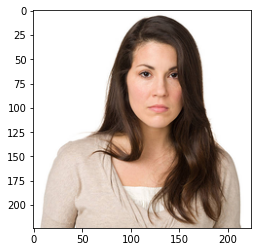

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


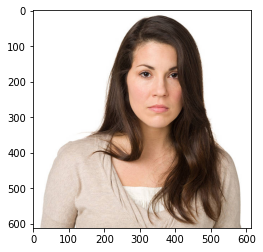

You are surprised


In [101]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Neutral/Neutral12.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

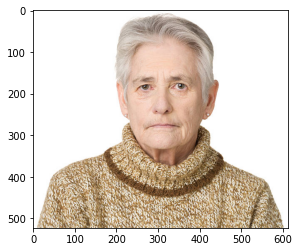

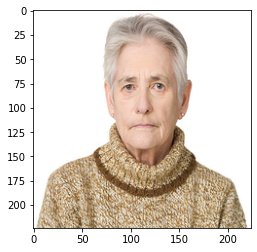

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


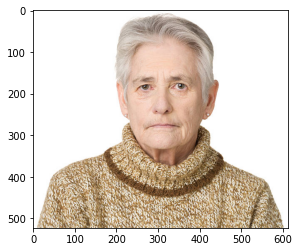

You are surprised


In [102]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Neutral/Neutral13.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

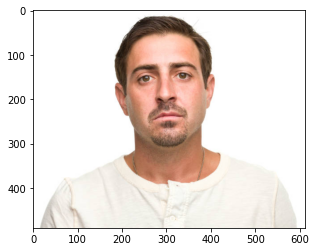

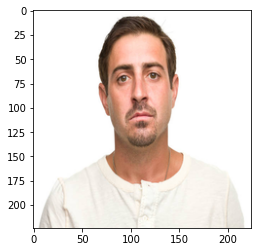

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


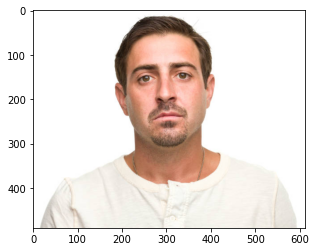

you are fear


In [103]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Neutral/Neutral14.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

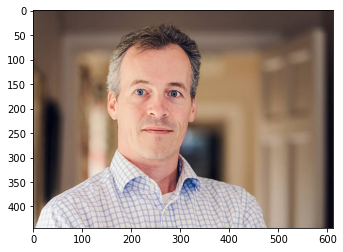

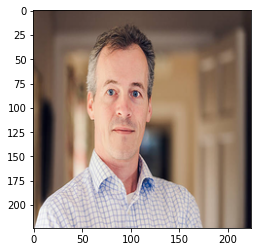

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


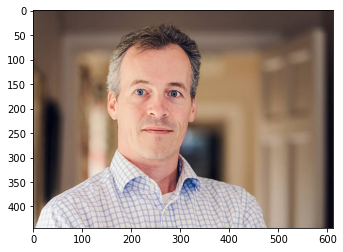

You are surprised


In [104]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Neutral/Neutral15.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

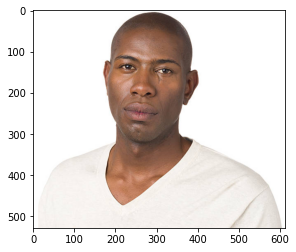

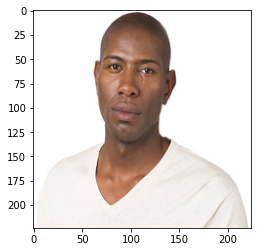

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


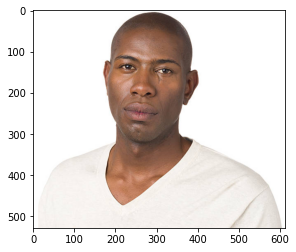

You are surprised


In [105]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Neutral/Neutral16.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

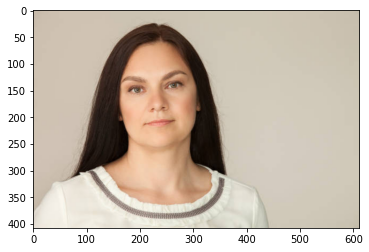

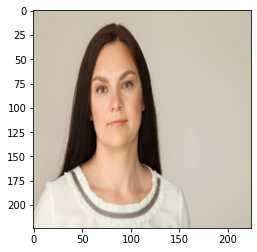

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


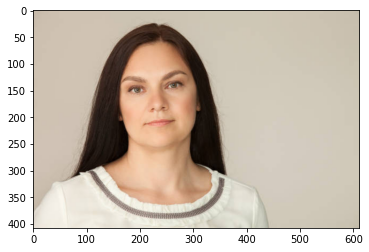

You are surprised


In [106]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Neutral/Neutral17.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

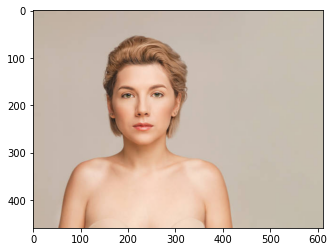

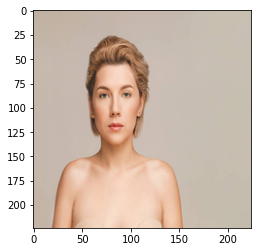

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


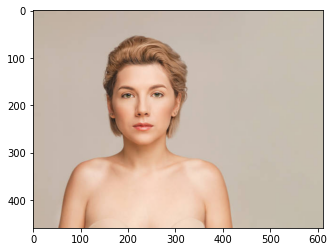

You are surprised


In [107]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Neutral/Neutral18.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

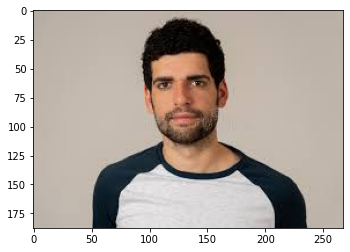

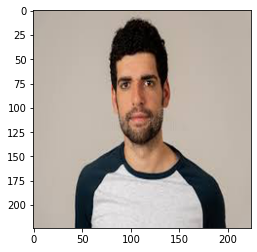

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


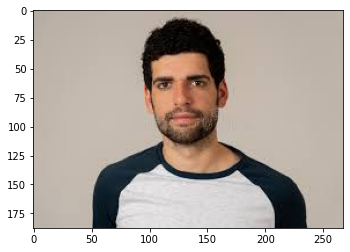

you are fear


In [108]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Neutral/Neutral19.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

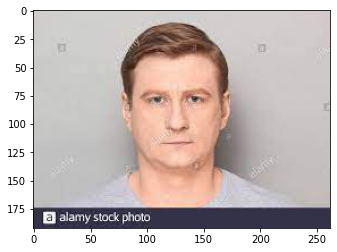

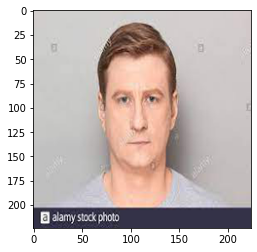

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


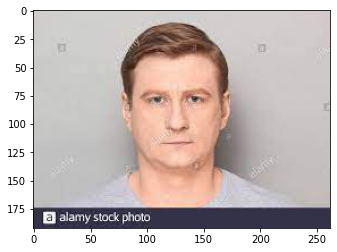

You are surprised


In [109]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Neutral/Neutral20.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

**Sad**

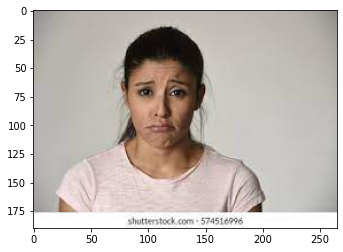

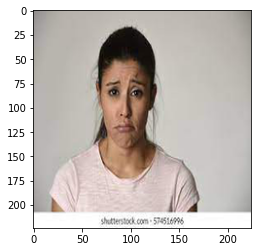

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


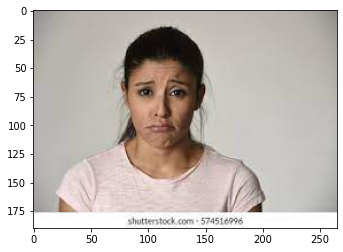

You are surprised


In [110]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Sad/Sad1.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

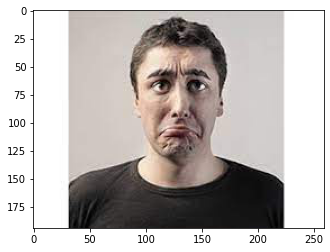

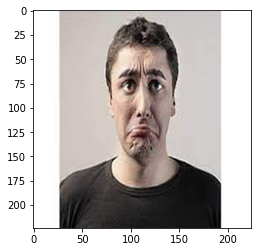

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


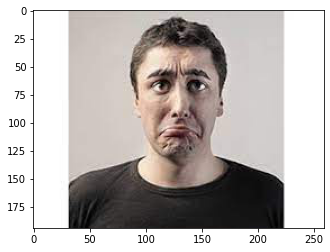

You are surprised


In [111]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Sad/Sad2.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

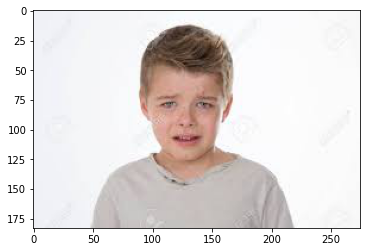

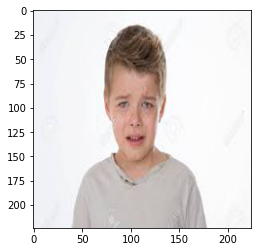

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


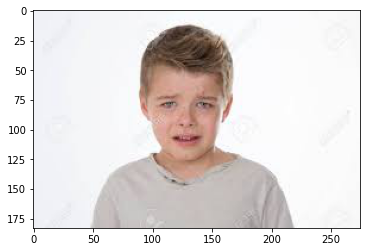

You are surprised


In [112]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Sad/Sad3.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

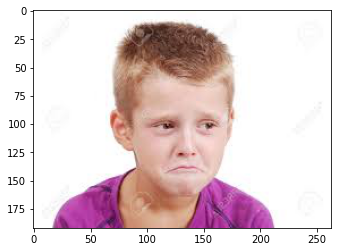

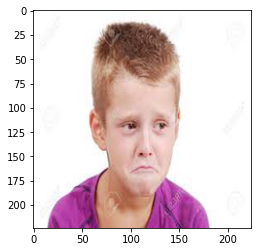

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


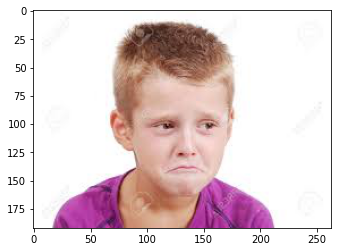

you are fear


In [113]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Sad/Sad4.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

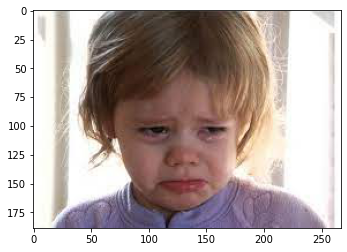

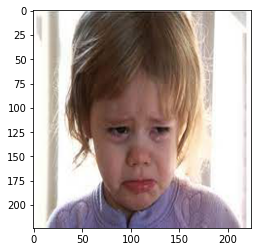

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


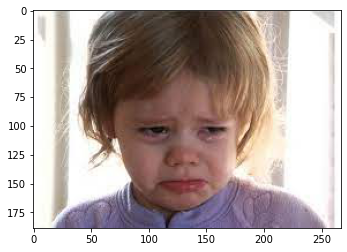

You are surprised


In [114]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Sad/Sad5.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

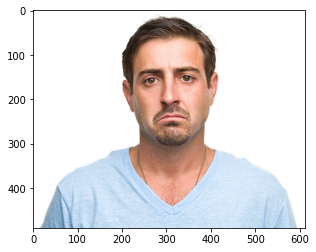

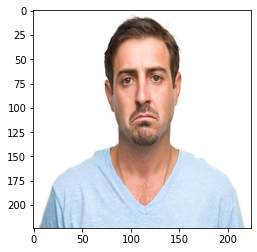

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


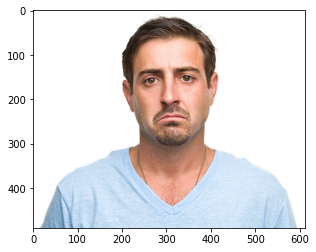

You are sad


In [115]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Sad/Sad6.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

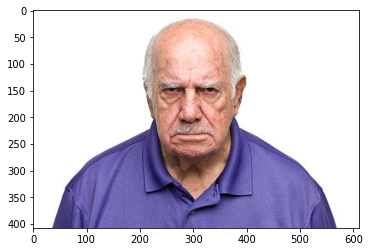

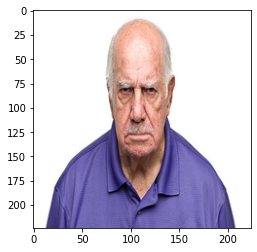

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


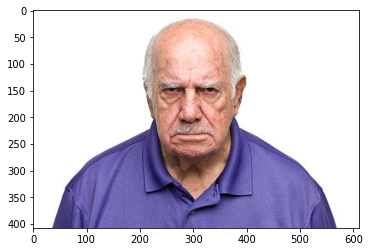

You are angry


In [116]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Sad/Sad7.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

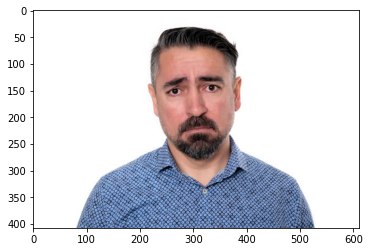

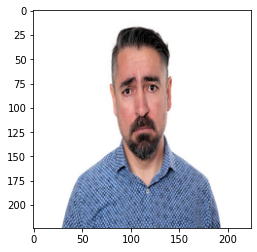

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


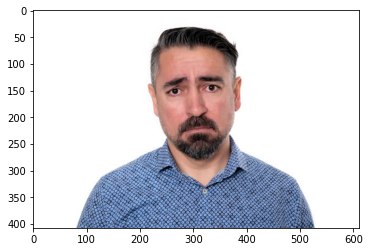

You are surprised


In [117]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Sad/Sad8.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

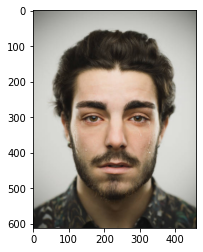

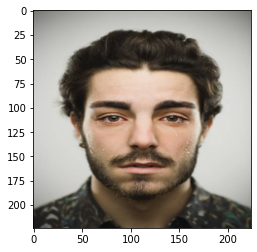

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


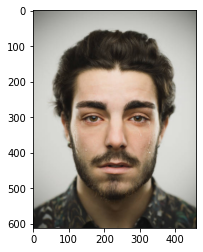

You are sad


In [118]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Sad/Sad9.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

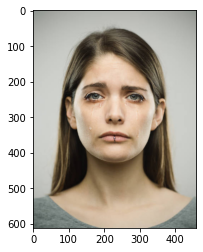

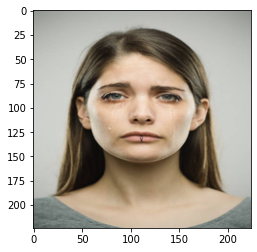

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


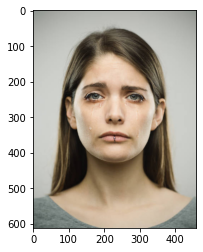

you are happy


In [119]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Sad/Sad10.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

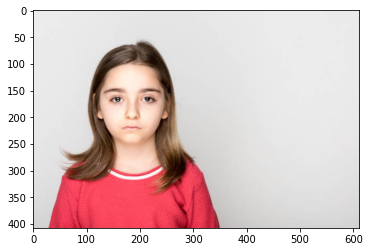

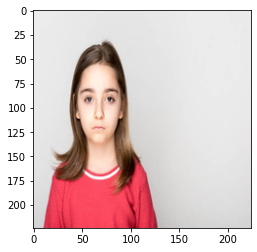

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


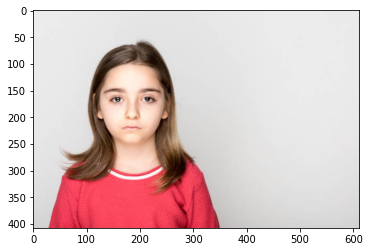

You are surprised


In [120]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Sad/Sad11.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

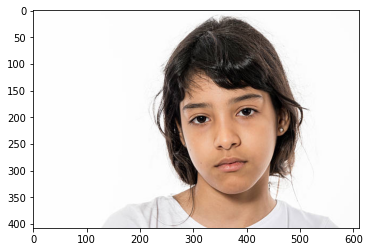

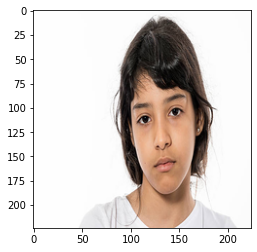

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


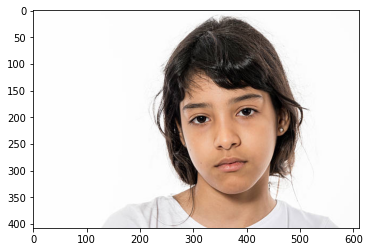

You are surprised


In [121]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Sad/Sad12.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

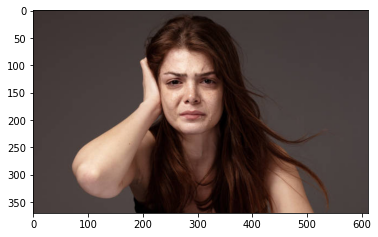

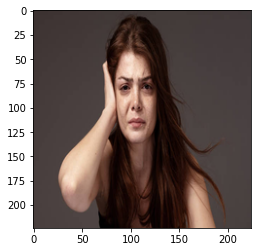

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


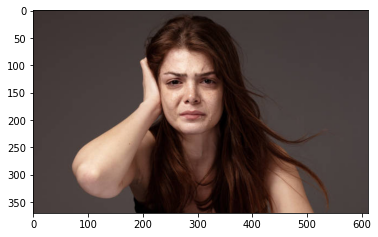

You are surprised


In [122]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Sad/Sad13.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

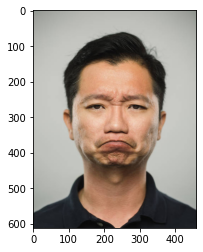

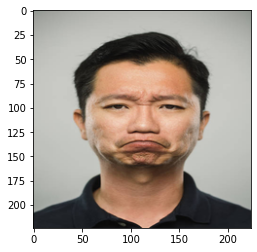

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


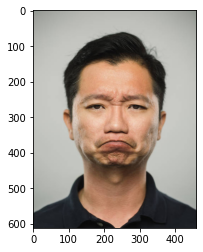

you are happy


In [123]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Sad/Sad14.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

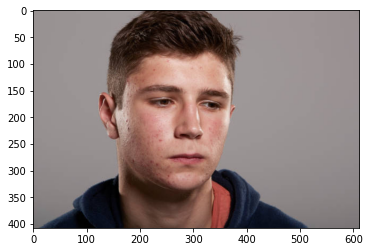

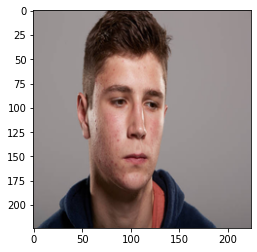

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


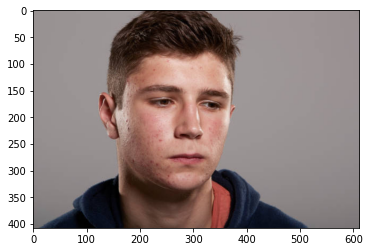

You are surprised


In [124]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Sad/Sad15.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

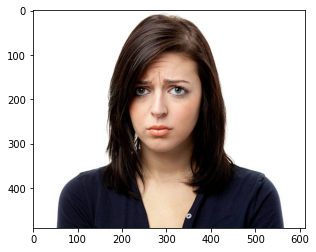

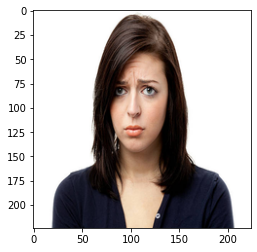

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


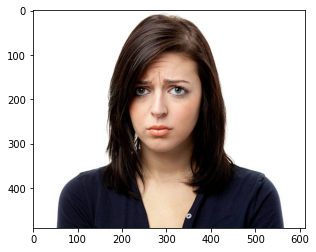

You are surprised


In [125]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Sad/Sad16.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

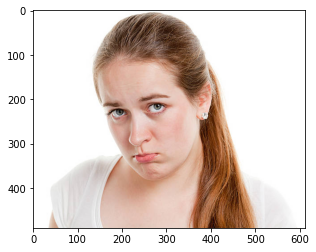

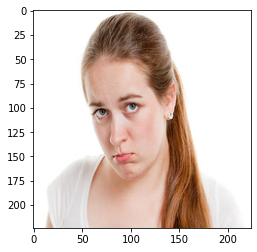

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


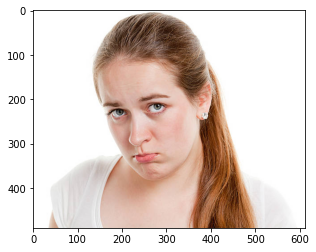

You are surprised


In [126]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Sad/Sad17.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

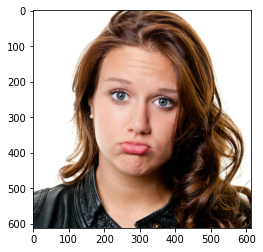

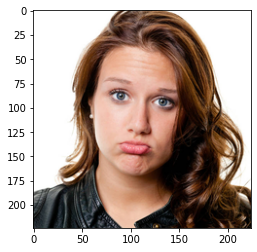

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


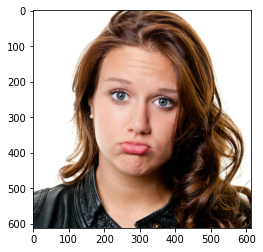

You are surprised


In [127]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Sad/Sad18.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

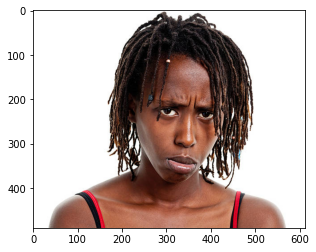

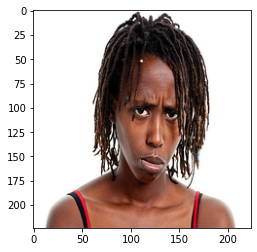

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


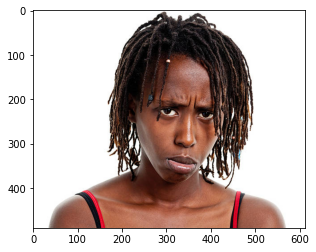

You are surprised


In [128]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Sad/Sad19.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

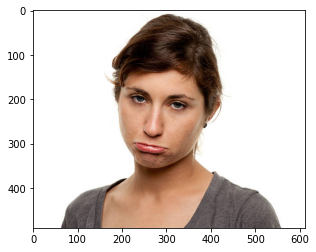

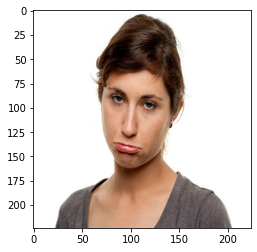

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


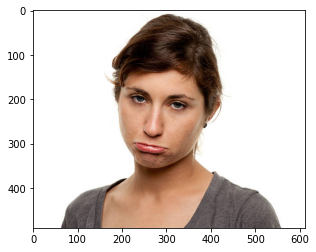

You are surprised


In [129]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Sad/Sad20.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

**Surprised**

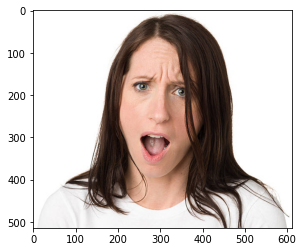

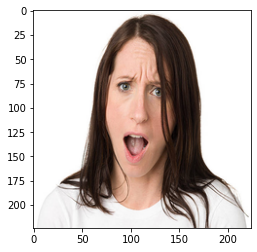

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


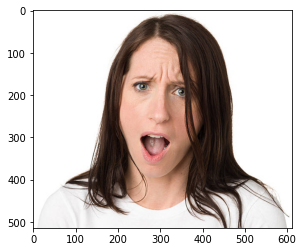

You are surprised


In [130]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Surprised/Surprised1.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

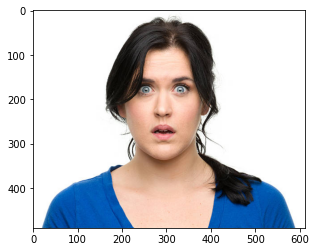

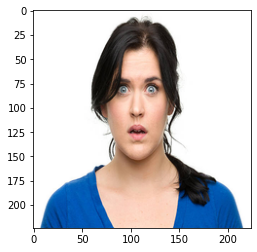

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


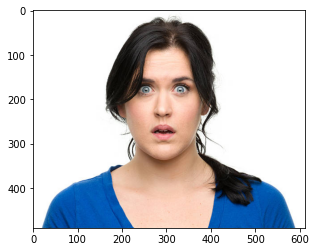

You are surprised


In [131]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Surprised/Surprised2.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

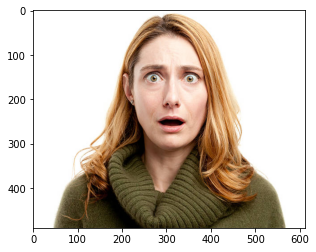

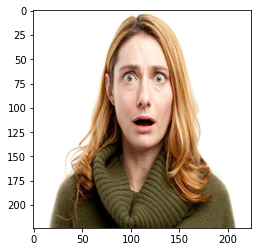

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


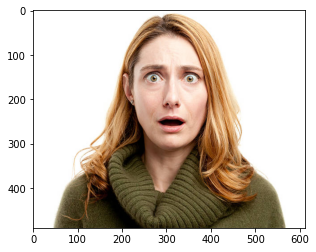

You are surprised


In [132]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Surprised/Surprised3.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

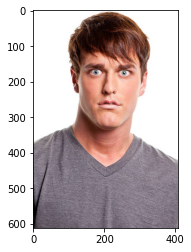

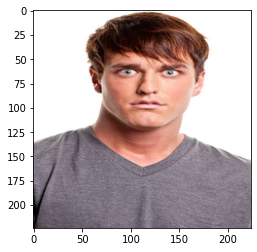

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


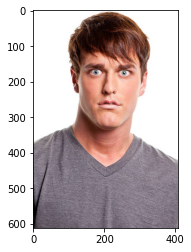

You are surprised


In [133]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Surprised/Surprised4.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

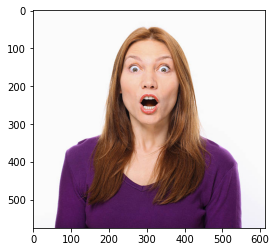

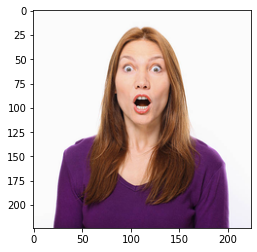

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


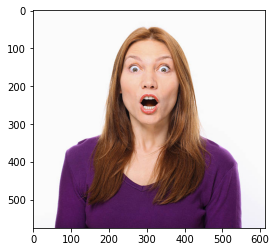

You are surprised


In [134]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Surprised/Surprised5.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

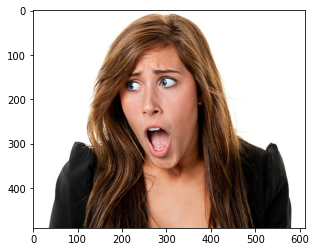

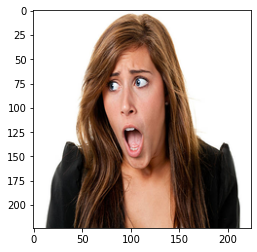

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


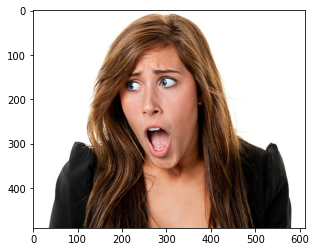

You are surprised


In [135]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Surprised/Surprised6.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

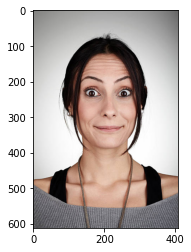

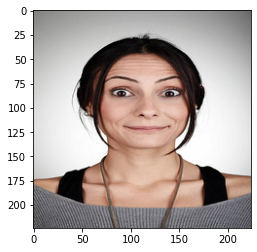

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


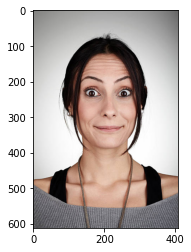

You are surprised


In [136]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Surprised/Surprised7.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

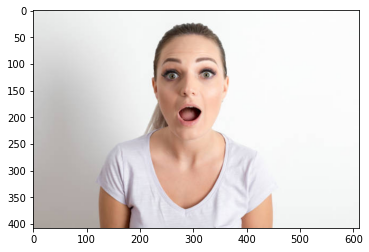

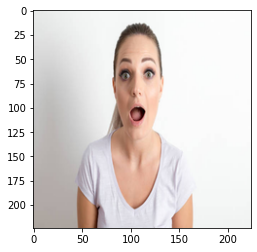

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


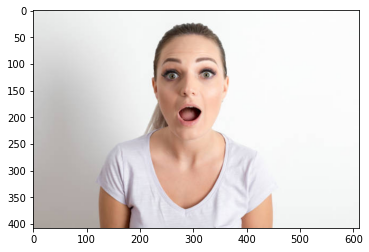

You are surprised


In [137]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Surprised/Surprised8.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

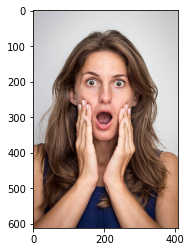

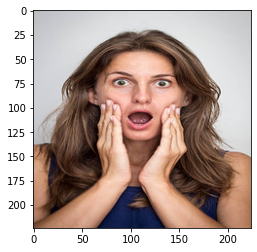

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


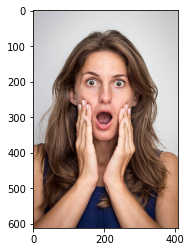

You are surprised


In [138]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Surprised/Surprised9.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

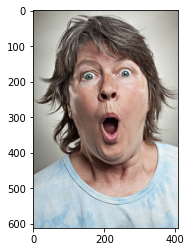

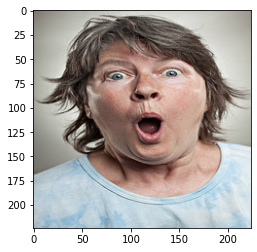

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


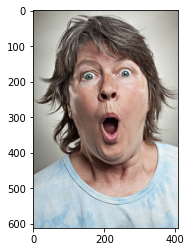

You are surprised


In [139]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Surprised/Surprised10.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

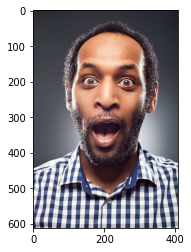

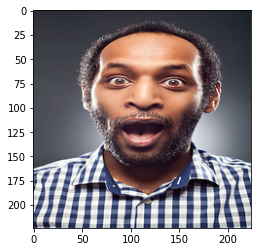

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


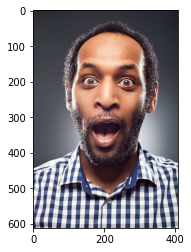

You are sad


In [140]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Surprised/Surprised11.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

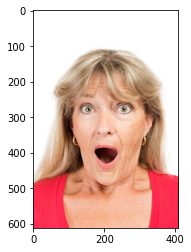

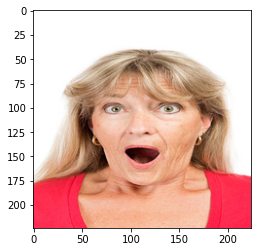

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


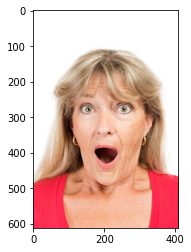

You are surprised


In [141]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Surprised/Surprised12.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

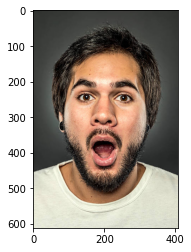

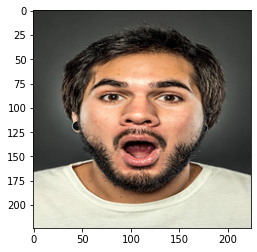

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


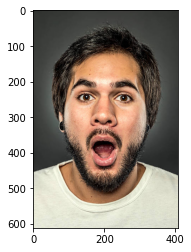

you are happy


In [142]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Surprised/Surprised13.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

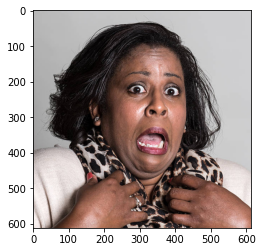

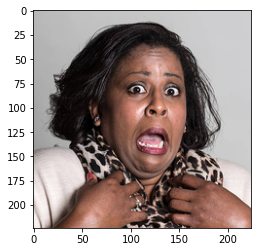

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


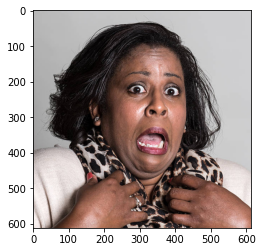

You are surprised


In [143]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Surprised/Surprised14.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

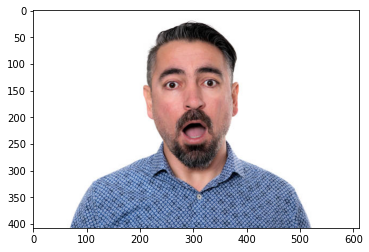

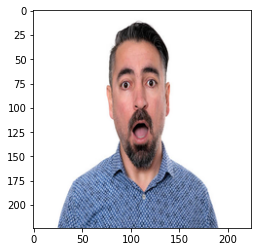

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


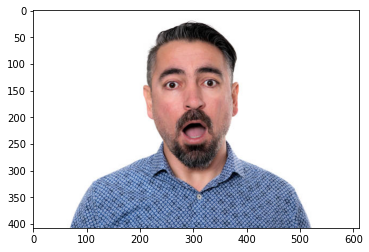

You are surprised


In [144]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Surprised/Surprised15.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

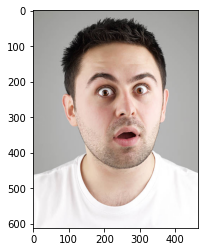

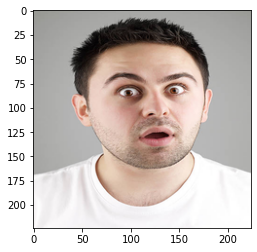

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


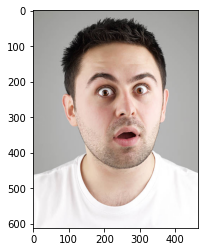

You are surprised


In [145]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Surprised/Surprised16.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

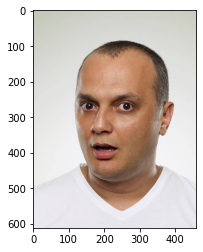

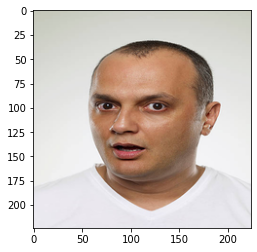

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


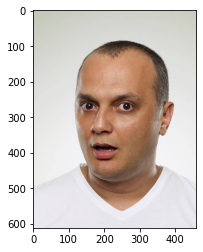

You are sad


In [146]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Surprised/Surprised17.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

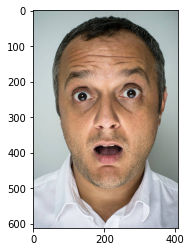

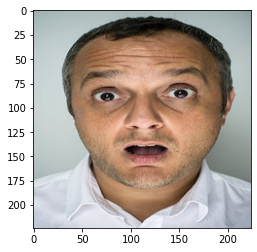

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


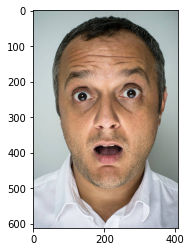

You are surprised


In [147]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Surprised/Surprised18.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

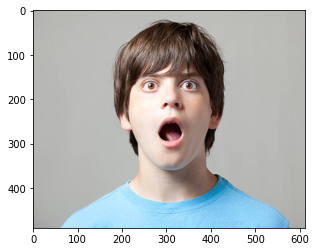

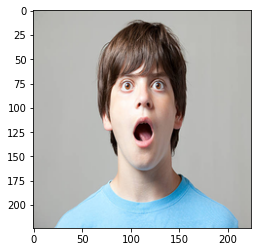

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


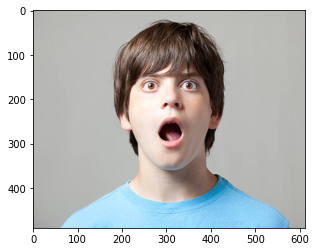

You are surprised


In [148]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Surprised/Surprised19.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")

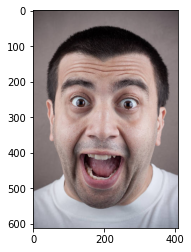

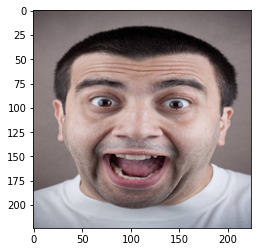

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


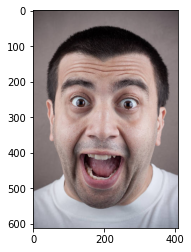

You are surprised


In [149]:
image1 =  Image.open("/content/drive/MyDrive/images/unclassifiedImages/Surprised/Surprised20.jpg")

plt.imshow(image1)
plt.show()
   
rgbImage = image1.resize((224,224),Image.ANTIALIAS).convert('RGB')
plt.imshow(rgbImage)
plt.show()

Xt = []
Xt.append(np.array(rgbImage))


# Convert to NP array
Xt = np.array(Xt)

# Reshape 2D
Xt = Xt.reshape(Xt.shape[0], 224, 224, 3).astype('float32')

# Normalize the data
Xt = Xt /255


result = model2.predict_classes(Xt)
#result = np.argmax(modelC.predict(Xt))

plt.imshow(image1)
plt.show()

if result[0] == 1:
    print("You are angry")
if result[0] == 2:
    print("You are disgusted")
if result[0] == 3:
    print("you are fear")
if result[0] == 4:
    print("you are happy")
if result[0] == 5:
    print("You are netural")
if result[0] == 6:
    print("You are sad")
if result[0] == 7:
    print("You are surprised")